# 1. Overview
This assignment consists of *three main parts* for which we expect you to provide code and extensive documentation in the notebook:
* Data exploration (Sect. 2)
* Image classification (Sect. 3)
* Semantic segmentation (Sect. 4)
* Submit to competition (Sect. 5)
* Adversarial attacks (Sect. 6)
* Discussion (Sect. 7)

In the first part, you will train an end-to-end neural network for image classification. In the second part, you will do the same for semantic segmentation. For these two tasks we expect you to put a significant effort into optimizing performance and as such competing with fellow students via the Kaggle competition. In the third part, you will try to find and exploit the weaknesses of your classification and/or segmentation network. For the latter there is no competition format, but we do expect you to put significant effort in achieving good performance on the self-posed goal for that part. Finally, we ask you to reflect and produce an overall discussion with links to the lectures and "real world" computer vision (Sect. 5). It is important to note that only a small part of the grade will reflect the actual performance of your networks. However, we do expect all things to work! In general, we will evaluate the correctness of your approach and your understanding of what you have done that you demonstrate in the descriptions and discussions in the final notebook.

## 1.1 Deep learning resources
If you did not yet explore this in * assignment 1 (Sect. 2)*, we recommend using the TensorFlow and/or Keras library for building deep learning models. You can find a nice crash course [here](https://colab.research.google.com/drive/1UCJt8EYjlzCs1H1d1X0iDGYJsHKwu-NO).

In [1]:
!pip install segmentation-models
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
import numpy as np
import pandas as pd
from matplotlib import pyplot as plt

import tensorflow as tf
from tensorflow.python.client import device_lib

gpus = tf.config.experimental.list_physical_devices('GPU')
for gpu in gpus:
  tf.config.experimental.set_memory_growth(gpu, True)

device_lib.list_local_devices()

/opt/conda/lib/python3.10/site-packages/scipy/__init__.py:146: UserWarning: A NumPy version >=1.16.5 and <1.23.0 is required for this version of SciPy (detected version 1.23.5
  warnings.warn(f"A NumPy version >={np_minversion} and <{np_maxversion}"


[name: "/device:CPU:0"
 device_type: "CPU"
 memory_limit: 268435456
 locality {
 }
 incarnation: 10055907351021598797
 xla_global_id: -1,
 name: "/device:GPU:0"
 device_type: "GPU"
 memory_limit: 16101670912
 locality {
   bus_id: 1
   links {
   }
 }
 incarnation: 11407121281057820781
 physical_device_desc: "device: 0, name: Tesla P100-PCIE-16GB, pci bus id: 0000:00:04.0, compute capability: 6.0"
 xla_global_id: 416903419]

## 1.2 PASCAL VOC 2009
For this project you will be using the [PASCAL VOC 2009](http://host.robots.ox.ac.uk/pascal/VOC/voc2009/index.html) dataset. This dataset consists of colour images of various scenes with different object classes (e.g. animal: *bird, cat, ...*; vehicle: *aeroplane, bicycle, ...*), totalling 20 classes.

The training set contains 749 examples.


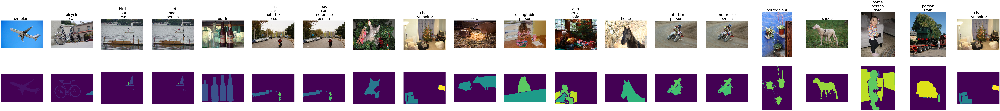

,aeroplane,bicycle,bird,boat,bottle,bus,car,cat,chair,cow,...,horse,motorbike,person,pottedplant,sheep,sofa,train,tvmonitor,img,seg
Id,,,,,,,,,,,,,,,,,,,,,
0,0,0,0,0,0,0,0,0,0,1,...,0,0,0,0,0,0,0,0,"[[[10, 8, 13], [16, 14, 19], [17, 14, 21], [19...","[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,..."


In [2]:
# Loading the training data
train_df_original = pd.read_csv('/kaggle/input/kul-h02a5a-computer-vision-ga2-2023/train/train_set.csv', index_col="Id")
labels = train_df_original.columns
train_df_original["img"] = [np.load('/kaggle/input/kul-h02a5a-computer-vision-ga2-2023/train/img/train_{}.npy'.format(idx)) for idx, _ in train_df_original.iterrows()]
train_df_original["seg"] = [np.load('/kaggle/input/kul-h02a5a-computer-vision-ga2-2023/train/seg/train_{}.npy'.format(idx)) for idx, _ in train_df_original.iterrows()]
print("The training set contains {} examples.".format(len(train_df_original)))


# Show some examples
fig, axs = plt.subplots(2, 20, figsize=(10 * 20, 10 * 2))
for i, label in enumerate(labels):
    df = train_df_original.loc[train_df_original[label] == 1]
    axs[0, i].imshow(df.iloc[0]["img"], vmin=0, vmax=255)
    axs[0, i].set_title("\n".join(label for label in labels if df.iloc[0][label] == 1), fontsize=40)
    axs[0, i].axis("off")
    axs[1, i].imshow(df.iloc[0]["seg"], vmin=0, vmax=20)  # with the absolute color scale it will be clear that the arrays in the "seg" column are label maps (labels in [0, 20])
    axs[1, i].axis("off")
    
plt.show()

# The training dataframe contains for each image 20 columns with the ground truth classification labels and 20 column with the ground truth segmentation maps for each class
train_df_original.head(1)

In [3]:
# Loading the test data
real_test_df = pd.read_csv('/kaggle/input/kul-h02a5a-computer-vision-ga2-2023/test/test_set.csv', index_col="Id")
real_test_df["img"] = [np.load('/kaggle/input/kul-h02a5a-computer-vision-ga2-2023/test/img/test_{}.npy'.format(idx)) for idx, _ in real_test_df.iterrows()]
real_test_df["seg"] = [-1 * np.ones(img.shape[:2], dtype=np.int8) for img in real_test_df["img"]]
print("The test set contains {} examples.".format(len(real_test_df)))

# The test dataframe is similar to the training dataframe, but here the values are -1 --> your task is to fill in these as good as possible in Sect. 2 and Sect. 3; in Sect. 6 this dataframe is automatically transformed in the submission CSV!
real_test_df.head(1)

The test set contains 750 examples.


,aeroplane,bicycle,bird,boat,bottle,bus,car,cat,chair,cow,...,horse,motorbike,person,pottedplant,sheep,sofa,train,tvmonitor,img,seg
Id,,,,,,,,,,,,,,,,,,,,,
0,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,...,-1,-1,-1,-1,-1,-1,-1,-1,"[[[139, 130, 115], [136, 127, 112], [112, 102,...","[[-1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, ..."


## 1.3 Your Kaggle submission
Your filled test dataframe (during Sect. 2 and Sect. 3) must be converted to a submission.csv with two rows per example (one for classification and one for segmentation) and with only a single prediction column (the multi-class/label predictions running length encoded). You don't need to edit this section. Just make sure to call this function at the right position in this notebook.

In [4]:
from cv2 import resize
from keras import layers, models, optimizers, regularizers, constraints, losses

def _rle_encode(img):
    """
    Kaggle requires RLE encoded predictions for computation of the Dice score (https://www.kaggle.com/lifa08/run-length-encode-and-decode)

    Parameters
    ----------
    img: np.ndarray - binary img array

    Returns
    -------
    rle: String - running length encoded version of img
    """
    pixels = img.flatten()
    pixels = np.concatenate([[0], pixels, [0]])
    runs = np.where(pixels[1:] != pixels[:-1])[0] + 1
    runs[1::2] -= runs[::2]
    rle = ' '.join(str(x) for x in runs)
    return rle

def generate_submission(df):
    """
    Make sure to call this function once after you completed Sect. 2 and Sect. 3! It transforms and writes your test dataframe into a submission.csv file.

    Parameters
    ----------
    df: pd.DataFrame - filled dataframe that needs to be converted

    Returns
    -------
    submission_df: pd.DataFrame - df in submission format.
    """
    df_dict = {"Id": [], "Predicted": []}
    for idx, _ in df.iterrows():
        df_dict["Id"].append(f"{idx}_classification")
        df_dict["Predicted"].append(_rle_encode(np.array(df.loc[idx, labels])))
        df_dict["Id"].append(f"{idx}_segmentation")
        df_dict["Predicted"].append(_rle_encode(np.array([df.loc[idx, "seg"] == j + 1 for j in range(len(labels))])))

    submission_df = pd.DataFrame(data=df_dict, dtype=str).set_index("Id")
    submission_df.to_csv("submission.csv")
    return submission_df

def resize_dataset(images, size):
    return np.asarray([resize(img, size)for img in images])

def plot_training(history_dict):
    acc = history_dict['accuracy']
    val_acc = history_dict['val_accuracy']

    loss = history_dict['loss']
    val_loss = history_dict['val_loss']

    dice = history_dict['dice_coeff']
    val_dice = history_dict['val_dice_coeff']

    epochs_range = range(len(loss))

    plt.figure(figsize=(11, 6))
    plt.subplot(1, 3, 1)
    plt.plot(epochs_range, acc, label='Training Accuracy')
    plt.plot(epochs_range, val_acc, label='Validation Accuracy')
    plt.legend()
    plt.title('Accuracy')

    plt.subplot(1, 3, 2)
    plt.plot(epochs_range, dice, label='Training Dice')
    plt.plot(epochs_range, val_dice, label='Validation Dice')
    plt.legend()
    plt.title('Dice')

    plt.subplot(1, 3, 3)
    plt.plot(epochs_range, loss, label='Training Loss')
    plt.plot(epochs_range, val_loss, label='Validation Loss')
    plt.legend()
    plt.title('Loss')

    plt.show()

# 2. Dataset exploration

Below is a histogram of the height and width of each image in the dataset.

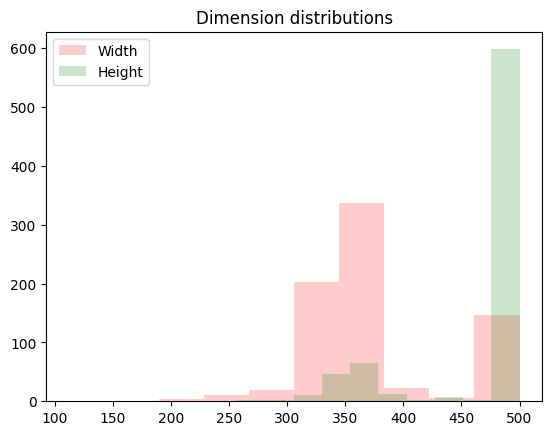

In [5]:
plt.hist(train_df_original['img'].apply(lambda x: x.shape[0]), color='r', label='Width',alpha=0.2)
plt.hist(train_df_original['img'].apply(lambda x: x.shape[1]), color='g', label='Height',alpha=0.2)
plt.title('Dimension distributions')
plt.legend()
plt.show()

Below is the ratio.

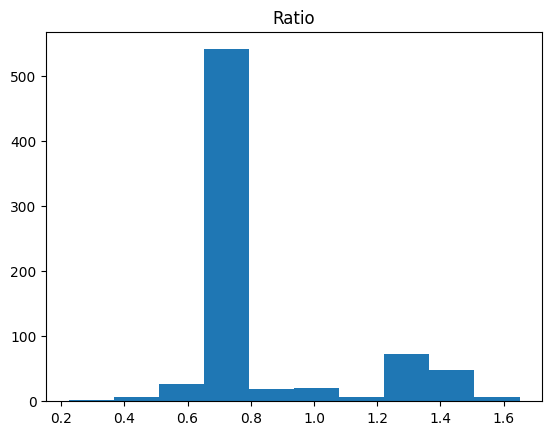

In [6]:
plt.hist(train_df_original['img'].apply(lambda x: x.shape[0]/x.shape[1]))
plt.title('Ratio')
plt.show()

And finally here are the high, width tuples. We can see that most of the images have size (375,350).

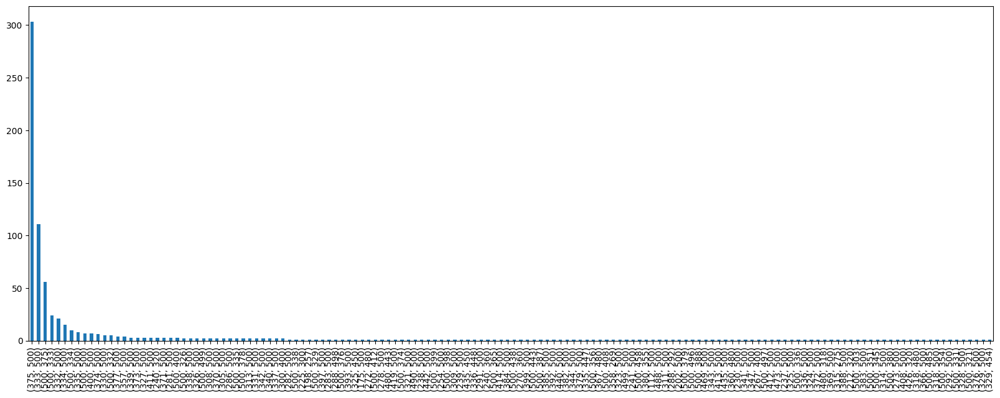

In [7]:
counts_dict = train_df_original['img'].apply(lambda x: (x.shape[0],x.shape[1])).value_counts()
fig, ax = plt.subplots(figsize=(20, 7))
counts_dict.plot.bar(ax=ax)
ax.set_xticklabels(counts_dict.index)
plt.show()

### Below we can see the class distribution. Its obvious that there are many more people in the images compared to other classes.

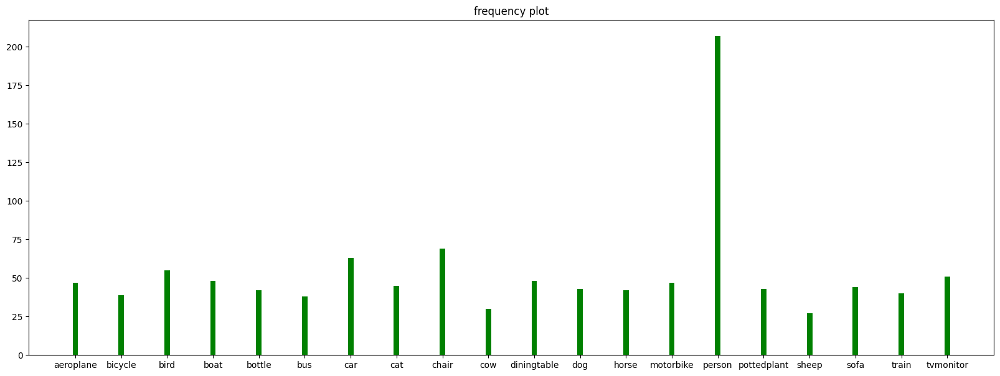

In [8]:
plt.figure(figsize=(20,7))
X_axis = np.arange(len(labels))
for i,label in enumerate(labels):
    plt.bar(5*i-0.2, len(train_df_original.loc[train_df_original[label]==1][label]), 0.6, color ='g', label='1')
plt.xticks(np.array(range(0,len(labels)))*5-0.2,labels)
plt.title('frequency plot')
plt.show()

Here we can see the number of labels per image, we can see that most images only have one label.

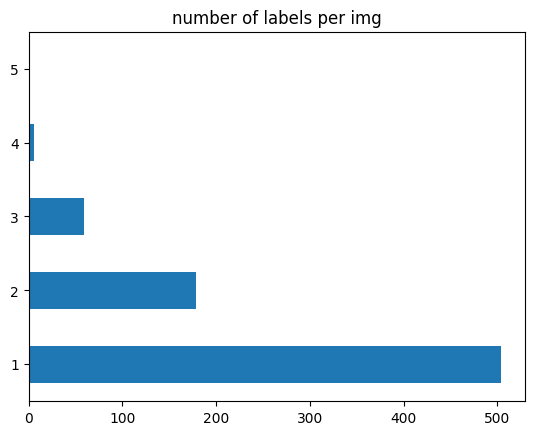

In [9]:
(train_df_original[labels] == 1).sum(axis=1).value_counts().plot.barh()
plt.title('number of labels per img')
plt.show()

Here is a correlation matrix for the classes. We can tell for example that "dining table" and "chair" (also chair and sofa) appear together in a lot of images, which makes sense. Moreover, "person" and "bird" or "airplane" don't usually appear together, which also makes sense.

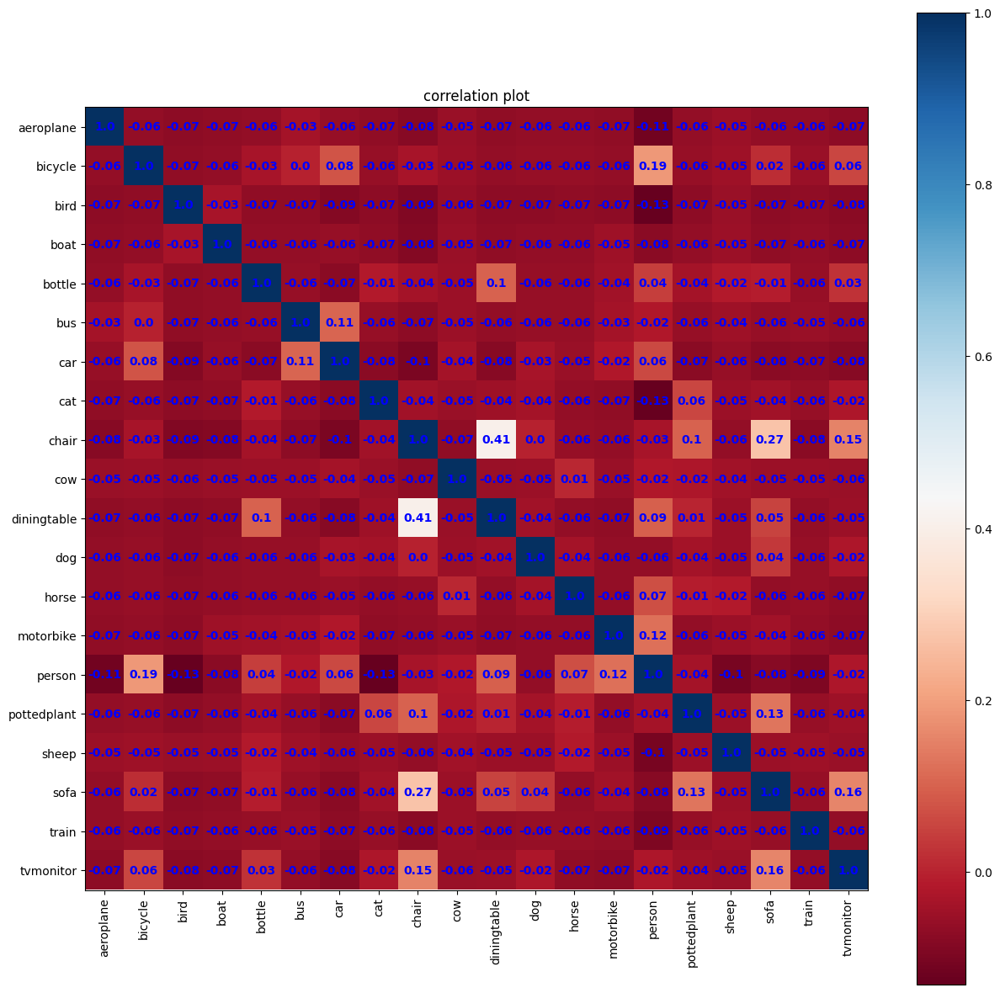

In [10]:
corr_matrix = train_df_original[labels].corr()

fig, ax = plt.subplots(figsize=(15, 15))
im = ax.imshow(corr_matrix, cmap='RdBu')
plt.colorbar(im)
ax.set_xticks(range(len(corr_matrix.columns)))
ax.set_yticks(range(len(corr_matrix.columns)))
ax.set_xticklabels(corr_matrix.columns, rotation=90)
ax.set_yticklabels(corr_matrix.columns)
ax.set_title('correlation plot')

for i in range(len(corr_matrix.columns)):
    for j in range(len(corr_matrix.columns)):
        text = ax.text(j, i, round(corr_matrix.iloc[i, j], 2), ha='center', va='center', color='b', weight='bold')


plt.show()

Here we can see the class distribution. Its obvious that there are many more background pixels the images compared to other classes.

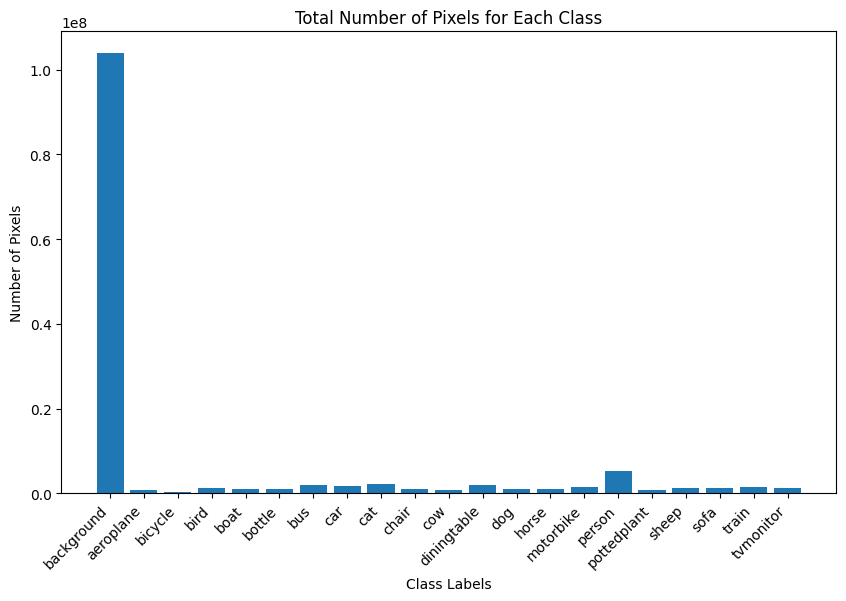

In [11]:
labels_tmp = np.insert(labels, 0, 'background')

# Calculate the total number of pixels for each class
class_counts = np.zeros(len(labels_tmp), dtype=int)

for image_seg in train_df_original["seg"]:
    unique_classes, counts = np.unique(image_seg, return_counts=True)
    for cls, count in zip(unique_classes, counts):
        if cls < len(labels_tmp):
            class_counts[cls] += count

# Create the bar plot
plt.figure(figsize=(10, 6))
plt.bar(labels_tmp, class_counts)
plt.xlabel('Class Labels')
plt.ylabel('Number of Pixels')
plt.title('Total Number of Pixels for Each Class')
plt.xticks(rotation=45, ha='right')
#plt.ylim(0.0, 2)

plt.show()

# 3. Image classification
The goal here is simple: implement a classification CNN and train it to recognise all 20 classes (and/or background) using the training set and compete on the test set (by filling in the classification columns in the test dataframe).

## 3.1 helper functions

We have a [data_augmentation](https://journalofbigdata.springeropen.com/articles/10.1186/s40537-019-0197-0) function that performs rounds of RandomFlip, RandomRotation, RandomZoom, RandomBrightness.
The training of both classification models was run with 5 rounds, meaning the training set is 6 times as large.

We have a threshold function that transforms the probabilities of the model predictions to 0 or 1.

We have a [dice_coeff](https://en.wikipedia.org/wiki/S%C3%B8rensen%E2%80%93Dice_coefficient) function that is a custom dice metric.

In [12]:
from tqdm.notebook import tqdm
import logging
import pickle

def data_augmentation(train_x, train_y, number_of_augmentations, use_data_augmentation, run_data_augmentation, data_augmentation_file):
    if run_data_augmentation:
        logging.getLogger('tensorflow').setLevel(logging.ERROR)
        model = models.Sequential([
                                                layers.RandomFlip("horizontal", input_shape=train_x[0].shape),
                                                layers.RandomRotation(0.1),
                                                layers.RandomZoom(0.1),
                                                layers.RandomBrightness(0.1),
                                              ])

        augmented_training = []
        augmented_y = []
        for _ in tqdm(range(number_of_augmentations)):
            augmented_training.append(model(train_x))
            augmented_y.append(train_y)
        train_x_tmp = np.concatenate(augmented_training)
        train_y_tmp = np.concatenate(augmented_y)

        logging.getLogger('tensorflow').setLevel(logging.WARNING)

        with open(data_augmentation_file, 'wb') as f:
            pickle.dump((train_x_tmp,train_y_tmp), f, protocol=4)

        if use_data_augmentation:
            train_x = train_x_tmp
            train_y = train_y_tmp
    else:
        if use_data_augmentation:
            with open(data_augmentation_file, 'rb') as f:
                train_x,train_y = pickle.load(f)

    dic={}
    for val in train_x:
        tmp=val.tobytes()
        if tmp in dic:
            dic[tmp]+=1
        else:
            dic[tmp]=0
    if len(dic.values())==len(train_y):
        print('no duplicates in dataset')
    else:
        print(len(train_y)-len(dic.values()),' duplicates')

    return train_x, train_y

def threshold(x, thresh=0.5):
    if x >= thresh:
        return 1
    else:
        return 0

def dice_coeff(y_true, y_pred, smooth=1e-5):
    y_true = tf.cast(y_true, dtype=tf.float32)
    y_pred = tf.cast(y_pred, dtype=tf.float32)
    intersection = tf.reduce_sum(y_true * y_pred)
    union = tf.reduce_sum(y_true) + tf.reduce_sum(y_pred)
    return (2. * intersection + smooth) / (union + smooth)

# def dice_loss(y_true, y_pred, smooth=1e-5): # don't use it, its vey hard to minimise
#     return 1.-dice_coeff(y_true, y_pred, smooth)

The Namespaces control some model and training parameters.

In [13]:
import argparse
args_custom_classification = argparse.Namespace(
    use_data_augmentation = False,# run with True
    run_training = False,

    early_stopping_patience = 10,
    learning_rate = 0.001,

    run_data_augmentation = False,
    number_of_augmentations = 5,
    checkpoint_file = '/kaggle/input/classification-custom/checkpoint.ckpt',
    history_file = '/kaggle/input/classification-pretrained/history.pkl',
    input_size = (375,500,3),
    data_augmentation_file = './train_augmented_classification_5.pkl',
    val_size = 0.2,
    test_size = 0.2,
    batch_size = 16
)

In [14]:
args_pretrained_classification = argparse.Namespace(
    use_data_augmentation = False,# run with True
    run_training = False,

    early_stopping_patience = 5,
    learning_rate = 0.0001,

    run_data_augmentation = False,
    number_of_augmentations = 5,
    checkpoint_file = '/kaggle/input/classification-pretrained/checkpoint.ckpt',
    history_file = '/kaggle/input/classification-pretrained/history.pkl',
    input_size = (375,500,3),
    data_augmentation_file = './train_augmented_classification_5.pkl',
    val_size = 0.2,
    test_size = 0.2,
    batch_size = 16
)

## 3.2 Custom model

First we split the data in train test validation. The train will be used to train our model, validation will be used for early stopping to avoid overfitting, test will be used to test our final model before we run it on the real test set for which we don't have labels.

We resize all the images to our dataset to be of constant size, chosen based on the plots in data exploration. CNNs can accept variable sizes as input, we will discuss that in the discussion section

In [15]:
train_df, val_df, test_df = np.split(train_df_original.sample(frac=1, random_state=42), [int((1.0-args_custom_classification.val_size-args_custom_classification.test_size)*len(train_df_original)), int((1.0-args_custom_classification.test_size)*len(train_df_original))])# no stratify

train_x_original = resize_dataset(train_df['img'],args_custom_classification.input_size[-2::-1])
train_y_original = train_df[labels]

val_x = resize_dataset(val_df['img'],args_custom_classification.input_size[-2::-1])
val_y = val_df[labels]

test_x = resize_dataset(test_df['img'],args_custom_classification.input_size[-2::-1])
test_y = test_df[labels]

Run or not the data augmentation based on the model parameters. The final model used 5 rounds of data augmentation (it is not apparent here because we couldn't load the pkl file in Kaggle because of ram limitations).

In [16]:
train_x, train_y = data_augmentation(train_x_original,train_y_original,
                                     args_custom_classification.number_of_augmentations,args_custom_classification.use_data_augmentation,
                                     args_custom_classification.run_data_augmentation,args_custom_classification.data_augmentation_file)
print(np.shape(train_y))

no duplicates in dataset
(449, 20)


Our classification model is a very simple version of [VGG](https://arxiv.org/abs/1409.1556) with some tweaks. It starts with 'simple' 32 filters and a max pooling and ends up with 'more complicated' 512 filters. Those are flattened and passed through a linear layer of size 20 with sigmoid activation, for the final predictions.
The final layer has 20 output neurons because we have 20 classes, sigmoid activation (instead of softmax) because we have multiple labels.
The CNN will learn 'simple' filters at the first layer, detecting lines. Those filters will be combined by the second layer to form more complicated features. The final layer will have detected more complicated objects in the image, we use those as features for the final classification layer.

For regularization we used kernel_regularizer=regularizers.l2 which applies the l2 penalty to the layers weights, kernel_constraint=constraints.unit_norm() that constrains the layers weight to have unit norm and dropout before the final layer. We will discuss those more later.

In [17]:
regularization = 0.2

model_classification_custom = models.Sequential(layers=[
                                    layers.Rescaling(1./255, input_shape=args_custom_classification.input_size),
                                    layers.Conv2D(32, 3, activation='relu',kernel_regularizer=regularizers.l2(l=regularization),kernel_constraint=constraints.unit_norm()),
                                    layers.MaxPooling2D(2),
                                    layers.Conv2D(64, 3, activation='relu',kernel_regularizer=regularizers.l2(l=regularization), kernel_constraint=constraints.unit_norm()),
                                    layers.MaxPooling2D(2),
                                    layers.Conv2D(128, 3, activation='relu',kernel_regularizer=regularizers.l2(l=regularization), kernel_constraint=constraints.unit_norm()),
                                    layers.MaxPooling2D(2),
                                    layers.Conv2D(256, 3, activation='relu',kernel_regularizer=regularizers.l2(l=regularization), kernel_constraint=constraints.unit_norm()),
                                    layers.MaxPooling2D(2),
                                    layers.Conv2D(512, 3, activation='relu',kernel_regularizer=regularizers.l2(l=regularization), kernel_constraint=constraints.unit_norm()),
                                    layers.Flatten(),
                                    layers.Dropout(0.5),
                                    layers.Dense(20, activation='sigmoid')
                                  ])

model_classification_custom.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 rescaling (Rescaling)       (None, 375, 500, 3)       0         
                                                                 
 conv2d (Conv2D)             (None, 373, 498, 32)      896       
                                                                 
 max_pooling2d (MaxPooling2D  (None, 186, 249, 32)     0         
 )                                                               
                                                                 
 conv2d_1 (Conv2D)           (None, 184, 247, 64)      18496     
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 92, 123, 64)      0         
 2D)                                                             
                                                                 
 conv2d_2 (Conv2D)           (None, 90, 121, 128)      7

Here is where the actual training of the model happens. We use class weights to deal with the class imbalance. We use binary crossentropy as a loss function and measure the accuracy and dice score of the model. As mentioned we use early stopping and save the best performing model.

In [18]:
history = None
if not args_custom_classification.run_training:
    model_classification_custom.load_weights(args_custom_classification.checkpoint_file)
    with open(args_custom_classification.history_file, 'rb') as f:
                history = pickle.load(f)

class_counts = np.sum(train_y, axis=0)
total_counts = np.sum(class_counts)
class_weights = {i: total_counts/(class_counts[i]*20) for i in range(20)}

model_classification_custom.compile(optimizer=optimizers.Adam(learning_rate=args_custom_classification.learning_rate),
              loss=losses.binary_crossentropy,
              metrics=['accuracy',dice_coeff])

if args_custom_classification.run_training:
    early_stopping = tf.keras.callbacks.EarlyStopping(monitor='val_dice_coeff', patience=args_custom_classification.early_stopping_patience,
                                                      mode='max', min_delta=0.009, verbose=1)
    checkpoints = tf.keras.callbacks.ModelCheckpoint(args_custom_classification.checkpoint_file, monitor='val_dice_coeff',
                                                     mode='max', save_best_only=True, save_weights_only=True, verbose=1)

    history = model_classification_custom.fit(x=train_x, y=train_y, callbacks=[early_stopping,checkpoints], class_weight=class_weights,
                        epochs=1000, validation_data=(val_x,val_y), batch_size=args_custom_classification.batch_size)
    history = history.history
    with open(args_custom_classification.history_file, 'wb') as f:
        pickle.dump(history, f)

Here we can see the training and validation accuracy, dice and loss plotted.
We can see that the model does not perform well. It is also obvious that we have overfitting.
To combat that we used dataset augmentation and the previously mentioned regularization techniques. L2 regularizer with 0.2 is very aggressive!
We tried models with much fewer parameters and they performed similarly, overfitted the data.

We kept this one as an example but all of them were basically the same, the best dice we got was 0.21.
We conclude that the number of training examples is not sufficient to train a CNN. Maybe a more traditional computer vision approach could perform better.

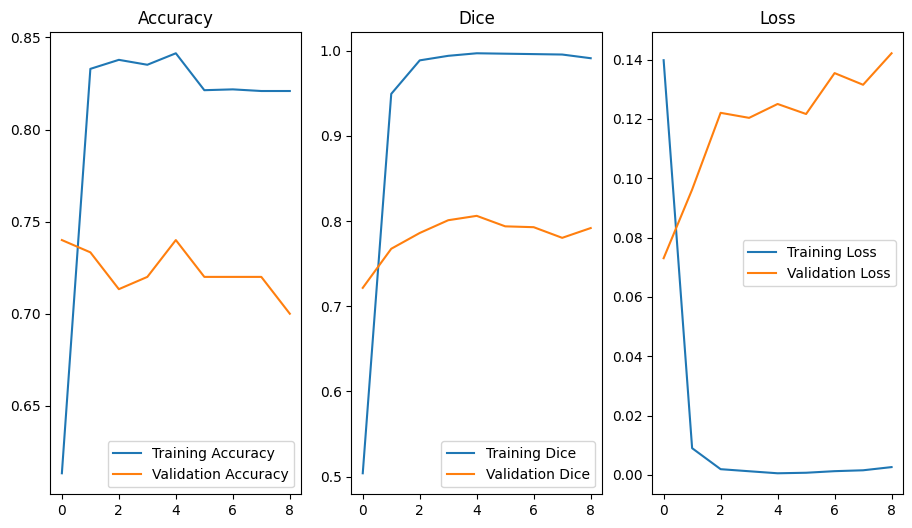

In [19]:
plot_training(history)

The scores in the testing set are exactly as expected, poor.

In [20]:
loss, accuracy, dice = model_classification_custom.evaluate(test_x, test_y)
print(f'Test loss: {loss:.4f}, Test accuracy: {accuracy:.4f}, Test dice: {dice:.4f}')

5/5 [==============================] - 4s 211ms/step - loss: 104770.3750 - accuracy: 0.1133 - dice_coeff: 0.1618
Test loss: 104770.3750, Test accuracy: 0.1133, Test dice: 0.1618


## 3.3 Pretrained model

Same as before we split, resize and use data augmentation. The final model used 5 rounds of data augmentation (it is not apparent here because we couldn't load the pkl file in Kaggle because of ram limitations).

In [21]:
train_df, val_df, test_df = np.split(train_df_original.sample(frac=1, random_state=42), [int((1.0-args_pretrained_classification.val_size-args_pretrained_classification.test_size)*len(train_df_original)), int((1.0-args_pretrained_classification.test_size)*len(train_df_original))])# no stratify

train_x_original = resize_dataset(train_df['img'],args_pretrained_classification.input_size[-2::-1])
train_y_original = train_df[labels]

val_x = resize_dataset(val_df['img'],args_pretrained_classification.input_size[-2::-1])
val_y = val_df[labels]

test_x = resize_dataset(test_df['img'],args_pretrained_classification.input_size[-2::-1])
test_y = test_df[labels]

In [22]:
train_x, train_y = data_augmentation(train_x_original,train_y_original,
                                     args_pretrained_classification.number_of_augmentations,args_pretrained_classification.use_data_augmentation,
                                     args_pretrained_classification.run_data_augmentation,args_pretrained_classification.data_augmentation_file)
print(np.shape(train_y))

no duplicates in dataset
(449, 20)


For the pretrained model we choose [Xception](https://arxiv.org/abs/1610.02357) trained on imagenet. The rest of the model follows the same basic principles as the custom one but has multiple 'CNN channels' that work together to produce a more complicated and complete image embedding.

In [23]:
model_classification_pretrained = models.Sequential(layers=[
                                    tf.keras.applications.Xception(include_top=False,weights='imagenet',input_shape=args_pretrained_classification.input_size),
                                    layers.Flatten(),
                                    layers.Dropout(0.5),
                                    layers.Dense(20, activation='sigmoid')
                                    ])
model_classification_pretrained.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 xception (Functional)       (None, 12, 16, 2048)      20861480  
                                                                 
 flatten_1 (Flatten)         (None, 393216)            0         
                                                                 
 dropout_1 (Dropout)         (None, 393216)            0         
                                                                 
 dense_1 (Dense)             (None, 20)                7864340   
                                                                 
Total params: 28,725,820
Trainable params: 28,671,292
Non-trainable params: 54,528
_________________________________________________________________


In [24]:
history = None
if not args_pretrained_classification.run_training:
    model_classification_pretrained.load_weights(args_pretrained_classification.checkpoint_file)
    with open(args_pretrained_classification.history_file, 'rb') as f:
                history = pickle.load(f)

class_counts = np.sum(train_y, axis=0)
total_counts = np.sum(class_counts)
class_weights = {i: total_counts/(class_counts[i]*20) for i in range(20)}

model_classification_pretrained.compile(optimizer=optimizers.Adam(learning_rate=args_pretrained_classification.learning_rate),
              loss=losses.binary_crossentropy,
              metrics=['accuracy', dice_coeff])

if args_pretrained_classification.run_training:
    early_stopping = tf.keras.callbacks.EarlyStopping(monitor='val_dice_coeff', patience=args_pretrained_classification.early_stopping_patience,
                                                      mode='max', min_delta=0.009, verbose=1)
    checkpoints = tf.keras.callbacks.ModelCheckpoint(args_pretrained_classification.checkpoint_file, monitor='val_dice_coeff',
                                                     mode='max', save_best_only=True, save_weights_only=True, verbose=1)

    history = model_classification_pretrained.fit(x=train_x, y=train_y, callbacks=[early_stopping,checkpoints], class_weight=class_weights,
                        epochs=1000, validation_data=(val_x,val_y), batch_size=args_pretrained_classification.batch_size)
    history = history.history
    with open(args_pretrained_classification.history_file, 'wb') as f:
        pickle.dump(history, f)

We can see that the model performs significantly better, no overfitting and nice dice score! Although the model has far more parameters compaired to the custom one, it does not overfit the data. This is because we use the pretrained version. That means that the model, already trained on a similar task on imagenet, starts at a very good local optimum for our problem (exept for the last linear layer which is random), during training we change the weights only a little to fine-tune the model and find the desired solution. This is obvious as the testing dice is 0.7+ on the first epoch, far better that the best dice of our custom model!

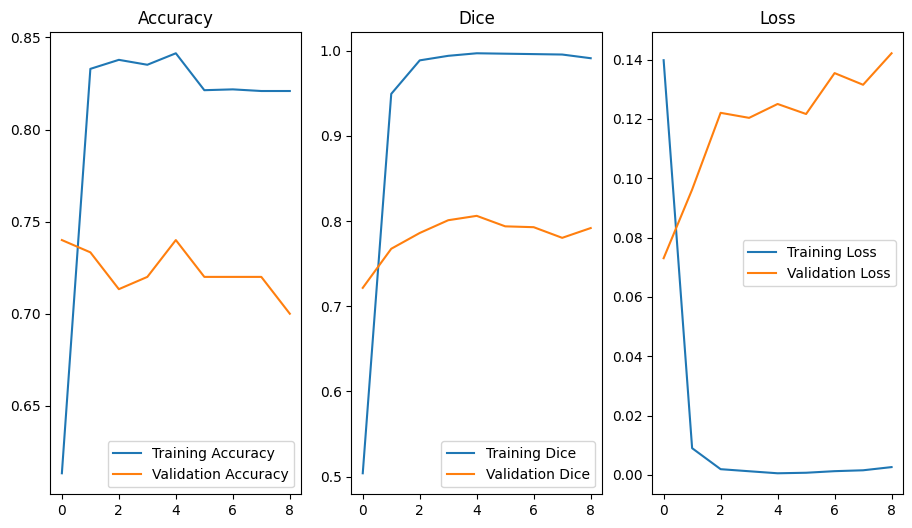

In [25]:
plot_training(history)

We get dice=0.8 on the testing set, as we did for the validation set, more proof of no overfitting.

In [26]:
loss, accuracy, dice = model_classification_pretrained.evaluate(test_x, test_y)
print(f'Test loss: {loss:.4f}, Test accuracy: {accuracy:.4f}, Test dice: {dice:.4f}')

5/5 [==============================] - 4s 395ms/step - loss: 0.1273 - accuracy: 0.7933 - dice_coeff: 0.8038
Test loss: 0.1273, Test accuracy: 0.7933, Test dice: 0.8038


Here we can see the precision, recall and f1-score per class. Notably the model performs really well on most classes exept for example tvmonitor, dog and person.

In [27]:
from sklearn.metrics import classification_report
preds = [[threshold(i) for i in arr]for arr in model_classification_pretrained.predict(test_x)]
print(classification_report(test_y, preds, zero_division=0, target_names=labels))

5/5 [==============================] - 2s 248ms/step
              precision    recall  f1-score   support

   aeroplane       1.00      1.00      1.00         7
     bicycle       1.00      0.30      0.46        10
        bird       1.00      0.87      0.93        15
        boat       0.71      1.00      0.83         5
      bottle       1.00      0.78      0.88         9
         bus       1.00      1.00      1.00         7
         car       0.92      0.65      0.76        17
         cat       1.00      0.88      0.93         8
       chair       0.70      0.70      0.70        10
         cow       0.83      0.83      0.83         6
 diningtable       1.00      0.50      0.67         8
         dog       1.00      0.75      0.86         4
       horse       0.69      0.92      0.79        12
   motorbike       1.00      0.89      0.94         9
      person       0.95      0.76      0.84        50
 pottedplant       0.25      0.25      0.25         4
       sheep       1.00     

Here we can see an example of some images and there real labels vs predicted labels. As expected tvmonitor, dog and person are not always predicted correctly.

1/1 [==============================] - 1s 542ms/step


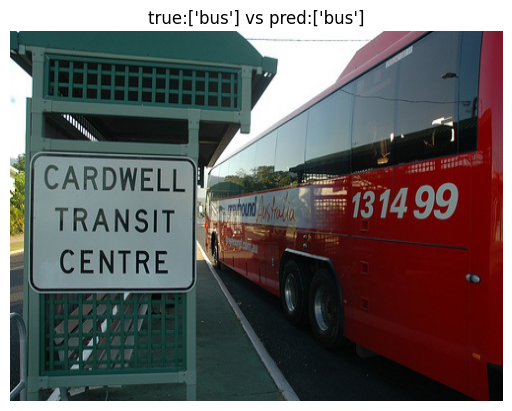

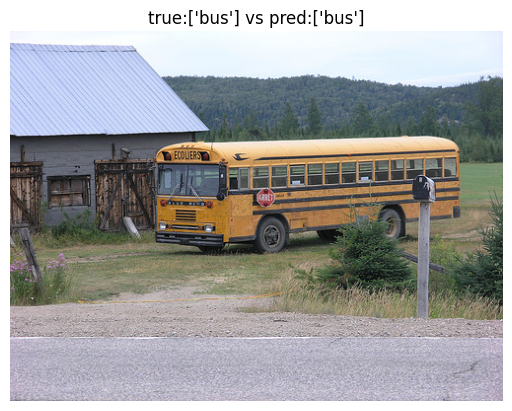

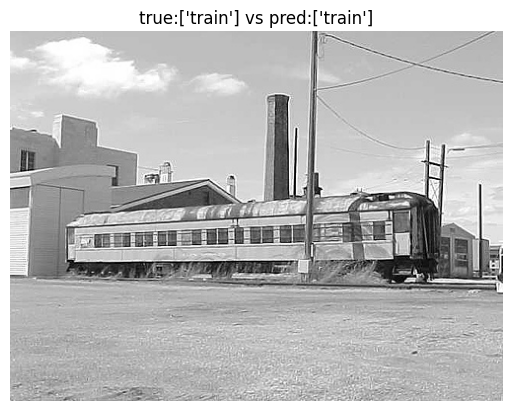

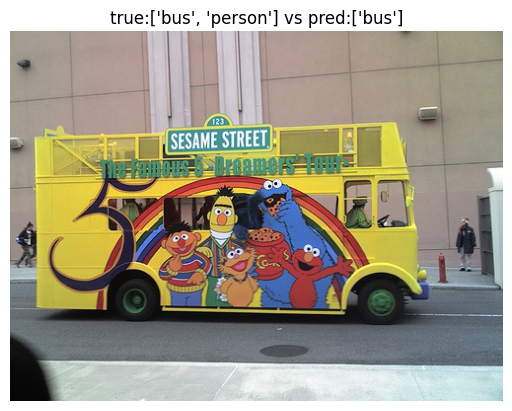

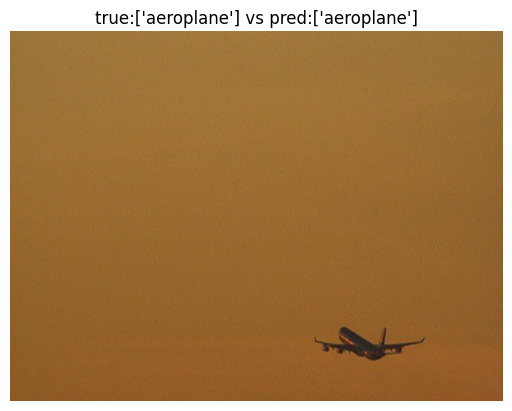

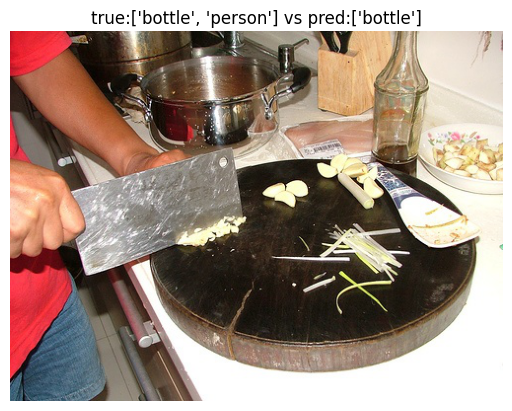

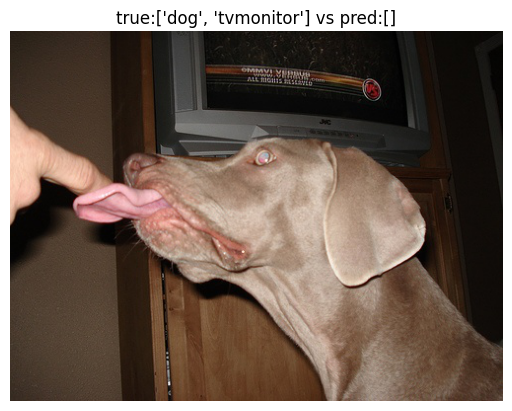

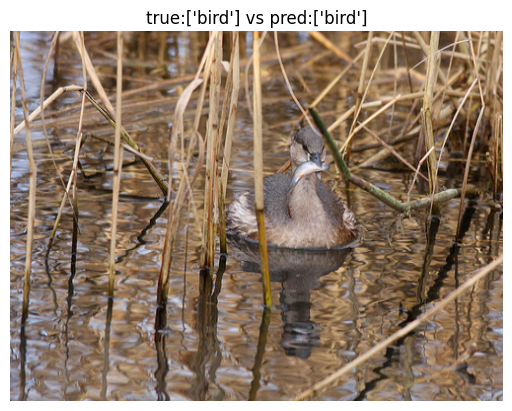

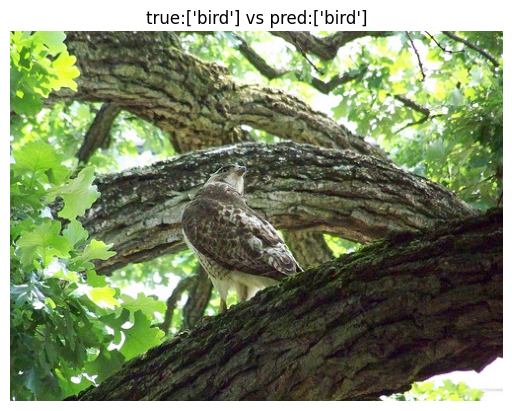

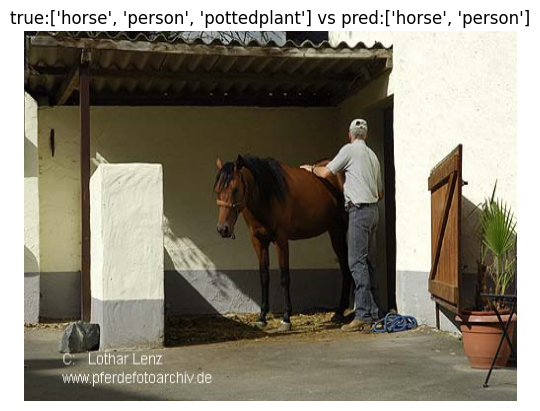

In [28]:
true_labels = [i[1][i[1] == 1].index.tolist() for i in test_y.head(10).iterrows()]
preds = [[threshold(i) for i in arr]for arr in model_classification_pretrained.predict(test_x[:10])]
pred_labels = [[l for i, l in enumerate(labels) if pred[i] == 1] for pred in preds]

for img, true, pred in zip(test_x[:10],true_labels,pred_labels):
    plt.imshow(img, vmin=0, vmax=255)
    plt.title(f"true:{true} vs pred:{pred}")
    plt.axis("off")
    plt.show()

In [29]:
# del model_classification_custom
# del model_classification_pretrained
tf.keras.backend.clear_session()
tf.config.experimental.reset_memory_stats('GPU:0')

# 4. Semantic segmentation
The goal here is to implement a segmentation CNN that labels every pixel in the image as belonging to one of the 20 classes (and/or background). Use the training set to train your CNN and compete on the test set (by filling in the segmentation column in the test dataframe).

## 4.1 Helper functions

We have a [data_augmentation](https://journalofbigdata.springeropen.com/articles/10.1186/s40537-019-0197-0) function that performs rounds of RandomFlip, RandomRotation.
The training of the custom segmentation model was run with 3 rounds, meaning the training set is 4 times as large. We did not use data augmentation for the pre-trained model.

We have a threshold function that transforms the probabilities of the model predictions to 0 or 1.

We have a [dice_coeff](https://en.wikipedia.org/wiki/S%C3%B8rensen%E2%80%93Dice_coefficient) class where we compute it with the help of the intersection-over-union via the confusion matrix.

We have a WeightedSparseCategoricalCrossentropy class to compute the weighted loss function.

In [30]:
from keras.metrics import IoU

def create_mask(pred_mask):
    pred_mask = np.argmax(pred_mask, axis=-1)
    return pred_mask

def data_augmentation(train_x, train_y, number_of_augmentations, use_data_augmentation, run_data_augmentation, data_augmentation_file):
    if run_data_augmentation:
        class Augmentation(layers.Layer):
          def __init__(self, seed):
            super().__init__()
            # both use the same seed, so they'll make the same random changes.
            self.layer1 = layers.RandomFlip("horizontal", input_shape=train_x[0].shape,seed=seed)
            self.layer2 = layers.RandomRotation(0.1,seed=seed, fill_value=0)
            # self.layer3 = layers.RandomZoom(0.1,seed=seed)

            self.layer1_ = layers.RandomFlip("horizontal", input_shape=train_y[0].shape,seed=seed)
            self.layer2_ = layers.RandomRotation(0.1,seed=seed, fill_value=0)
            # self.layer3_ = layers.RandomZoom(0.1,seed=seed)

          def call(self, inputs, masks):
            out_input = self.layer1(inputs)
            out_input = self.layer2(out_input)
            # out_input = self.layer3(out_input)

            out_mask = self.layer1_(masks)
            out_mask = self.layer2_(out_mask)
            # out_mask = self.layer3_(out_mask)
            return out_input, out_mask

        logging.getLogger('tensorflow').setLevel(logging.ERROR)
        augmented_training = []
        augmented_y = []
        for i in tqdm(range(number_of_augmentations)):
            model = Augmentation(i)
            x, y = model(train_x,train_y)
            augmented_training.append(x)
            augmented_y.append(y)
        train_x_tmp = np.concatenate(augmented_training)
        train_y_tmp = np.concatenate(augmented_y)

        logging.getLogger('tensorflow').setLevel(logging.WARNING)

        with open(data_augmentation_file, 'wb') as f:
            pickle.dump((train_x_tmp,train_y_tmp), f, protocol=4)

        if use_data_augmentation:
            train_x = train_x_tmp
            train_y = train_y_tmp
    else:
        if use_data_augmentation:
            with open(data_augmentation_file, 'rb') as f:
                train_x,train_y = pickle.load(f)

    dic={}
    for val in train_x:
        tmp=val.tobytes()
        if tmp in dic:
            dic[tmp]+=1
        else:
            dic[tmp]=0
    if len(dic.values())==len(train_y):
        print('no duplicates in dataset')
    else:
        print(len(train_y)-len(dic.values()),' duplicates')

    return train_x, train_y

class dice_coeff(IoU):#changed from meanIOU
    def __init__(self,num_classes,name="dice_coeff",dtype=None,axis: int = -1):
        target_class_ids = list(range(num_classes))
        super().__init__(name=name,axis=axis,dtype=dtype, target_class_ids=target_class_ids,
                         sparse_y_pred=False,num_classes=num_classes)

    def result(self):
        """Compute the intersection-over-union via the confusion matrix."""
        sum_over_row = tf.cast(tf.reduce_sum(self.total_cm, axis=0), dtype=self._dtype)
        sum_over_col = tf.cast(tf.reduce_sum(self.total_cm, axis=1), dtype=self._dtype)
        true_positives = tf.cast(tf.linalg.tensor_diag_part(self.total_cm), dtype=self._dtype)
        # sum_over_row + sum_over_col =
        #     2 * true_positives + false_positives + false_negatives.
        denominator = sum_over_row + sum_over_col
        # If the denominator is 0, we need to ignore the class.
        num_valid_entries = tf.reduce_sum(tf.cast(tf.not_equal(denominator, 0), dtype=self._dtype))
        dice = tf.math.divide_no_nan(2.*true_positives, denominator)
        return tf.math.divide_no_nan(tf.reduce_sum(dice, name="dice_coeff"), num_valid_entries)

class WeightedSparseCategoricalCrossentropy(tf.keras.losses.Loss):
        def __init__(self, class_weights, from_logits=False, name='weighted_scce'):
            super(WeightedSparseCategoricalCrossentropy, self).__init__()
            if class_weights is None:
                self.class_weights = None
            else:
                self.class_weights = tf.convert_to_tensor(class_weights,dtype=tf.float32)
            self.name = name
            self.unreduced_scce = losses.SparseCategoricalCrossentropy(
                from_logits=from_logits, name=name,
                reduction=tf.keras.losses.Reduction.NONE)

        def __call__(self, y_true, y_pred, sample_weight=None):
            loss = self.unreduced_scce(y_true, y_pred, sample_weight)
            if self.class_weights is not None:
                with tf.device('GPU:0'):
                    weight_mask = tf.gather(self.class_weights, y_true)
                    loss = tf.math.multiply(loss, weight_mask)
            return loss

The Namespaces control some model and training parameters.

In [31]:
import argparse
args_custom_segmentation = argparse.Namespace(
    use_data_augmentation = False,
    run_training = False,
    run_data_augmentation = False,

    early_stopping_patience = 10,
    learning_rate = 0.0001,

    number_of_augmentations = 3,
    checkpoint_file = '/kaggle/input/segmentation-custom/checkpoint.ckpt',
    history_file = '/kaggle/input/segmentation-custom/history.pkl',
    data_augmentation_file = './train_augmented_segmentation_3.pkl',

    input_size = (512,512,3),
    val_size = 0.2,
    test_size = 0.2,
    batch_size = 4
)

In [32]:
args_pretrained_segmentation = argparse.Namespace(
    use_data_augmentation = False,
    run_training = False,
    run_data_augmentation = False,

    early_stopping_patience = 5,
    learning_rate = 0.0001,

    number_of_augmentations = 3,
    checkpoint_file = '/kaggle/input/segmentation-pretrained/checkpoint.ckpt',
    history_file = '/kaggle/input/segmentation-pretrained/history.pkl',
    data_augmentation_file = './train_augmented_segmentation_3.pkl',

    input_size = (512,512,3),
    val_size = 0.2,
    test_size = 0.2,
    batch_size = 4
)

## 4.2 Custom model

First we split the data in train test validation. The train will be used to train our model, validation will be used for early stopping to avoid overfitting, test will be used to test our final model before we run it on the real test set for which we don't have labels.

We resize all the images to our dataset to be of constant size, chosen based on the plots in data exploration. CNNs can accept variable sizes as input, we will discuss that in the discussion section.

In [33]:
train_df, val_df, test_df = np.split(train_df_original.sample(frac=1, random_state=42), [int((1.0-args_custom_segmentation.val_size-args_custom_segmentation.test_size)*len(train_df_original)), int((1.0-args_custom_segmentation.test_size)*len(train_df_original))])

train_x_original = resize_dataset(train_df['img'],args_custom_segmentation.input_size[-2::-1])
train_y_original = resize_dataset(train_df['seg'],args_custom_segmentation.input_size[-2::-1])

val_x = resize_dataset(val_df['img'],args_custom_segmentation.input_size[-2::-1])
val_y = resize_dataset(val_df['seg'],args_custom_segmentation.input_size[-2::-1])

test_x = resize_dataset(test_df['img'],args_custom_segmentation.input_size[-2::-1])
test_y = resize_dataset(test_df['seg'],args_custom_segmentation.input_size[-2::-1])

Run or not the data augmentation based on the model parameters. The final custom model used 3 rounds of data augmentation (it is not apparent here because we couldn't load the pkl file in Kaggle because of ram limitations).

In [34]:
train_x, train_y = data_augmentation(train_x_original,train_y_original,
                                     args_custom_segmentation.number_of_augmentations,args_custom_segmentation.use_data_augmentation,
                                     args_custom_segmentation.run_data_augmentation,args_custom_segmentation.data_augmentation_file)
print(np.shape(train_y))

no duplicates in dataset
(449, 512, 512)


Our segmentation model is a simple version of [U-Net](https://arxiv.org/abs/1505.04597). It starts with 'simple' 64 filters and a max pooling and goes up until 512 filters, this is the 'bottleneck'. Then it "mirrors" while starting to upscale to 256,128,64 and eventually 21 filters. Those "steps up" are made with UpSampling2D and Concatenate.

The final layer has 21 output neurons because we have 20 classes (plus the background), sigmoid activation (instead of softmax) because we have multiple labels.

For regularization, we used "Dropout". The dropout technique works by randomly setting a fraction of input units to 0 at each training update. These "dropped out" units are not considered during forward or backward propagation. By doing this, dropout prevents the network from relying too heavily on specific input features or co-adapting with other neurons.
The dropout rate is set to 0.5, meaning that each neuron in the respective layer has a 50% chance of being dropped out during training.

In [35]:
from keras.layers import Input, Rescaling, Conv2D, MaxPooling2D, UpSampling2D, Concatenate, Dropout
from keras.models import Model

regularization = 0.02

def create_model(input_shape):
    inputs = Input(input_shape)
    rescale = Rescaling(scale=1./255)(inputs)

    conv0 = Conv2D(64, 3, activation='relu', padding='same')(rescale)
    conv0 = Dropout(0.5)(conv0)
    conv0 = Conv2D(64, 3, activation='relu', padding='same')(conv0)
    pool0 = MaxPooling2D(pool_size=(2, 2))(conv0)

    conv1 = Conv2D(128, 3, activation='relu', padding='same')(pool0)
    conv1 = Dropout(0.5)(conv1)
    conv1 = Conv2D(128, 3, activation='relu', padding='same')(conv1)
    pool1 = MaxPooling2D(pool_size=(2, 2))(conv1)

    conv2 = Conv2D(256, 3, activation='relu', padding='same')(pool1)
    conv2 = Dropout(0.5)(conv2)
    conv2 = Conv2D(256, 3, activation='relu', padding='same')(conv2)
    pool2 = MaxPooling2D(pool_size=(2, 2))(conv2)

    conv_mid = Conv2D(512, 3, activation='relu', padding='same')(pool2)
    # conv_mid = Dropout(0.5)(conv_mid)
    # conv_mid = Conv2D(512, 3, activation='relu', padding='same')(conv_mid)

    up5 = UpSampling2D(size=(2, 2))(conv_mid)
    up5 = Concatenate()([up5, conv2])
    conv5 = Conv2D(256, 3, activation='relu', padding='same')(up5)
    conv5 = Dropout(0.5)(conv5)
    conv5 = Conv2D(256, 3, activation='relu', padding='same')(conv5)

    up6 = UpSampling2D(size=(2, 2))(conv5)
    up6 = Concatenate()([up6, conv1])
    conv6 = Conv2D(128, 3, activation='relu', padding='same')(up6)
    conv6 = Dropout(0.5)(conv6)
    conv6 = Conv2D(128, 3, activation='relu', padding='same')(conv6)

    up7 = UpSampling2D(size=(2, 2))(conv6)
    up7 = Concatenate()([up7, conv0])
    conv7 = Conv2D(64, 3, activation='relu', padding='same')(up7)
    conv7 = Dropout(0.5)(conv7)
    conv7 = Conv2D(64, 3, activation='relu', padding='same')(conv7)

    outputs = Conv2D(21, 1, activation='sigmoid')(conv7)

    return Model(inputs, outputs)

model_segmentation_custom = create_model(input_shape=args_custom_segmentation.input_size)
model_segmentation_custom.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 512, 512, 3  0           []                               
                                )]                                                                
                                                                                                  
 rescaling (Rescaling)          (None, 512, 512, 3)  0           ['input_1[0][0]']                
                                                                                                  
 conv2d (Conv2D)                (None, 512, 512, 64  1792        ['rescaling[0][0]']              
                                )                                                                 
                                                                                              

Here is where the actual training of the model happens. We use class weights to deal with the class imbalance. We use WeightedSparseCategoricalCrossentropy as a loss function and measure the accuracy and dice score of the model. As mentioned we use early stopping and save the best performing model.

In [36]:
history = None
if not args_custom_segmentation.run_training:
    model_segmentation_custom.load_weights(args_custom_segmentation.checkpoint_file)
    with open(args_custom_segmentation.history_file, 'rb') as f:
                history = pickle.load(f)

class_weights = np.concatenate((np.array([0.1]), np.ones(20)))

model_segmentation_custom.compile(optimizer=optimizers.Adam(learning_rate=args_custom_segmentation.learning_rate),
                     loss=WeightedSparseCategoricalCrossentropy(class_weights=class_weights),
                     metrics=['accuracy',dice_coeff(num_classes=21)])

if args_custom_segmentation.run_training:
    early_stopping = tf.keras.callbacks.EarlyStopping(monitor='val_dice_coeff',patience=args_custom_segmentation.early_stopping_patience,
                                                      mode='max', min_delta=0.009, verbose=1)

    checkpoints = tf.keras.callbacks.ModelCheckpoint(args_custom_segmentation.checkpoint_file,monitor='val_dice_coeff',mode='max',
                                                     save_best_only=True,save_weights_only=True, verbose=1)

    history = model_segmentation_custom.fit(x=train_x, y=train_y.astype('int32'), callbacks=[early_stopping,checkpoints], epochs=1000,
                               validation_data=(val_x,val_y.astype('int32')),
                               batch_size=args_custom_segmentation.batch_size)
    history = history.history

    with open(args_custom_segmentation.history_file, 'wb') as f:
        pickle.dump(history, f)

Here we can see the training and validation accuracy, dice and loss plotted.

Accuracy is not a good metric in this particular case because more than 50% is actually background.

We used dice, when we can observe that practically it should have increased as the model proceeds through each next epoch, however it stays a straight line (only changes in the .00X decimal and plotted here as so for better visuals).

Concerning the loss function, we used Sparce Categorical Cross Entropy which is a good loss because and in our case we also added weights. However, for the reasons explained before (small training set, etc), we clearly observe an underfit in the loss plot, indicative of the incapacity of the model to learn.

We tried models with much more parameters and less dropout and they performed similarly, underfitting the data.

We kept this one as an example but all of them were basically the same, the best dice we got was 0.10.

We conclude that the number of training examples is not sufficient to train a CNN. Maybe a more traditional computer vision approach could perform better.

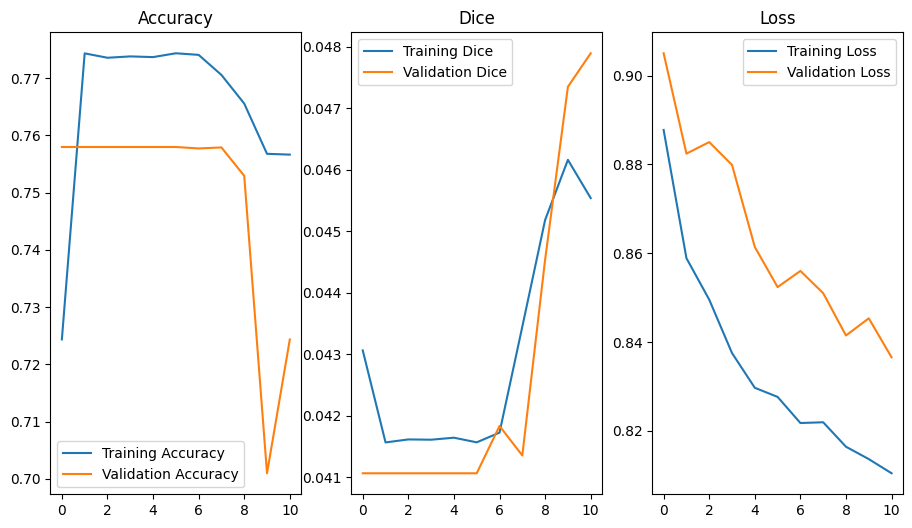

In [37]:
plot_training(history)

In [38]:
loss, accuracy, dice = model_segmentation_custom.evaluate(test_x, test_y.astype("int32"), batch_size=args_custom_segmentation.batch_size)
print(f'Test loss: {loss:.4f}, Test accuracy: {accuracy:.4f}, Test dice: {dice:.4f}')

38/38 [==============================] - 12s 188ms/step - loss: 0.7549 - accuracy: 0.7647 - dice_coeff: 0.0543
Test loss: 0.7549, Test accuracy: 0.7647, Test dice: 0.0543


We can see from the predicted masks, our model performs poorly. Some classes are better than others, but still the overall dice is not good.

1/1 [==============================] - 7s 7s/step


<Figure size 640x480 with 0 Axes>

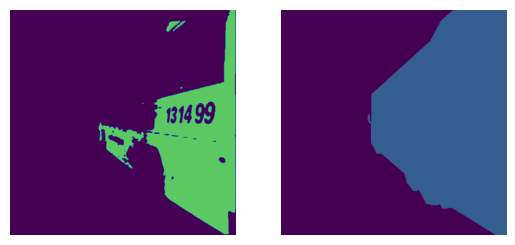

<Figure size 640x480 with 0 Axes>

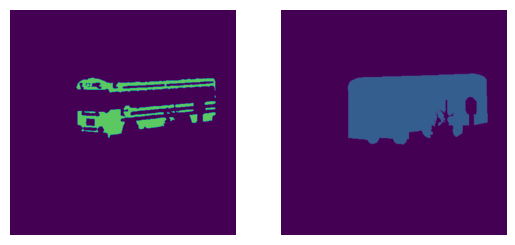

<Figure size 640x480 with 0 Axes>

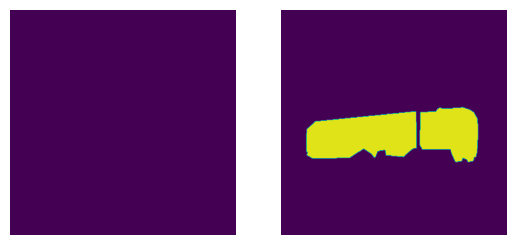

<Figure size 640x480 with 0 Axes>

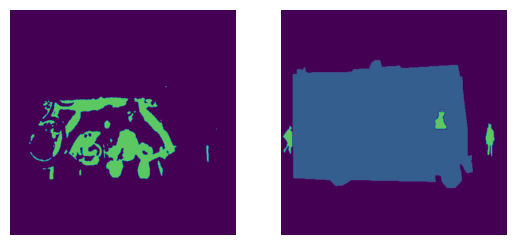

<Figure size 640x480 with 0 Axes>

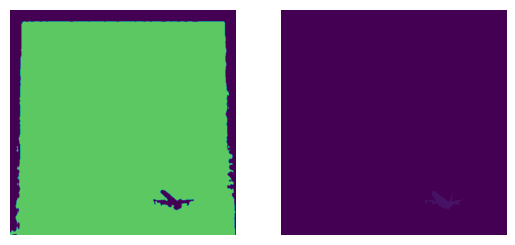

<Figure size 640x480 with 0 Axes>

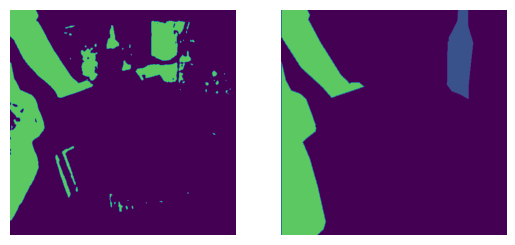

<Figure size 640x480 with 0 Axes>

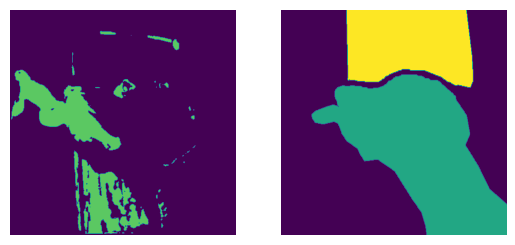

<Figure size 640x480 with 0 Axes>

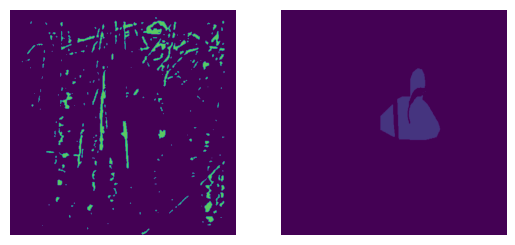

<Figure size 640x480 with 0 Axes>

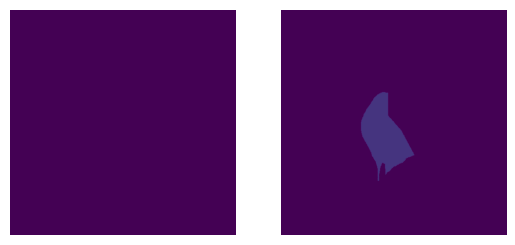

<Figure size 640x480 with 0 Axes>

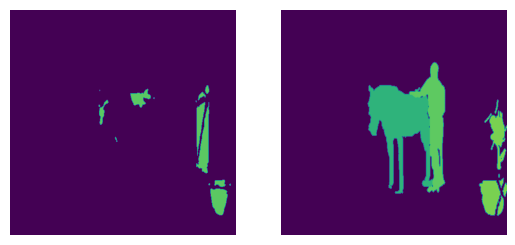

In [39]:
temp = [create_mask(i) for i in model_segmentation_custom.predict(test_x[:10])]
for i in range(10):
    plt.figure()
    f, axarr = plt.subplots(1, 2)
    axarr[0].imshow(temp[i], vmin=0, vmax=20)
    axarr[1].imshow(test_y[i], vmin=0, vmax=20)
    axarr[0].axis("off")
    axarr[1].axis("off")
    plt.show()

## 4.3 Pretrained model

Split and resize as before

In [40]:
train_df, val_df, test_df = np.split(train_df_original.sample(frac=1, random_state=42), [int((1.0-args_pretrained_segmentation.val_size-args_pretrained_segmentation.test_size)*len(train_df_original)), int((1.0-args_pretrained_segmentation.test_size)*len(train_df_original))])

train_x_original = resize_dataset(train_df['img'],args_pretrained_segmentation.input_size[-2::-1])
train_y_original = resize_dataset(train_df['seg'],args_pretrained_segmentation.input_size[-2::-1])

val_x = resize_dataset(val_df['img'],args_pretrained_segmentation.input_size[-2::-1])
val_y = resize_dataset(val_df['seg'],args_pretrained_segmentation.input_size[-2::-1])

test_x = resize_dataset(test_df['img'],args_pretrained_segmentation.input_size[-2::-1])
test_y = resize_dataset(test_df['seg'],args_pretrained_segmentation.input_size[-2::-1])

Data augmentation. This model was run without any data augmentation.

In [41]:
train_x, train_y = data_augmentation(train_x_original,train_y_original,
                                     args_pretrained_segmentation.number_of_augmentations,args_pretrained_segmentation.use_data_augmentation,
                                     args_pretrained_segmentation.run_data_augmentation,args_pretrained_segmentation.data_augmentation_file)
print(np.shape(train_y))

no duplicates in dataset
(449, 512, 512)


For the pretrained model we choose [FPN](https://arxiv.org/abs/1612.03144v2) with [resnet50](https://arxiv.org/abs/1512.03385) trained on imagenet. Resnet is a deep CNN with residual connections and its used as backbone for the FPN. We followed the paper, without using data augmentation.

In [42]:
import os
os.environ["SM_FRAMEWORK"] = "tf.keras"
import segmentation_models as sm

model_segmentation_pretrained = sm.FPN('resnet50', encoder_weights='imagenet', classes=21, input_shape=args_pretrained_segmentation.input_size,
                         activation='sigmoid', encoder_freeze=True)

# model_segmentation_pretrained.summary()

Segmentation Models: using `tf.keras` framework.


In [43]:
history = None
if not args_pretrained_segmentation.run_training:
    model_segmentation_pretrained.load_weights(args_pretrained_segmentation.checkpoint_file)
    with open(args_pretrained_segmentation.history_file, 'rb') as f:
                history = pickle.load(f)

class_weights = np.concatenate((np.array([0.2]), np.ones(20)))

model_segmentation_pretrained.compile(optimizer=optimizers.Adam(learning_rate=args_pretrained_segmentation.learning_rate),
              loss=WeightedSparseCategoricalCrossentropy(class_weights=class_weights),
              metrics=['accuracy', dice_coeff(num_classes=21)])

if args_pretrained_segmentation.run_training:
    early_stopping = tf.keras.callbacks.EarlyStopping(monitor='val_dice_coeff', patience=args_pretrained_segmentation.early_stopping_patience,
                                                      mode='max', min_delta=0.009, verbose=1)
    checkpoints = tf.keras.callbacks.ModelCheckpoint(args_pretrained_segmentation.checkpoint_file, monitor='val_dice_coeff',
                                                     mode='max', save_best_only=True, save_weights_only=True, verbose=1)

    history = model_segmentation_pretrained.fit(x=train_x, y=train_y.astype('int32'), callbacks=[early_stopping,checkpoints], epochs=1000,
                                 validation_data=(val_x,val_y.astype('int32')), batch_size=args_pretrained_segmentation.batch_size)
    history = history.history
    with open(args_pretrained_segmentation.history_file, 'wb') as f:
        pickle.dump(history, f)

We can see that the model performs significantly better, no overfitting and nice dice score! The pretrained model resnet50, already trained on classification on imagenet, starts at a very good local optimum for our problem, during training we freeze the resnet weights and only train the upscaling FPN pyramid (whose weights start from scratch). The testing dice is 0.4+ on the first epoch, far better that the best dice of our custom model!

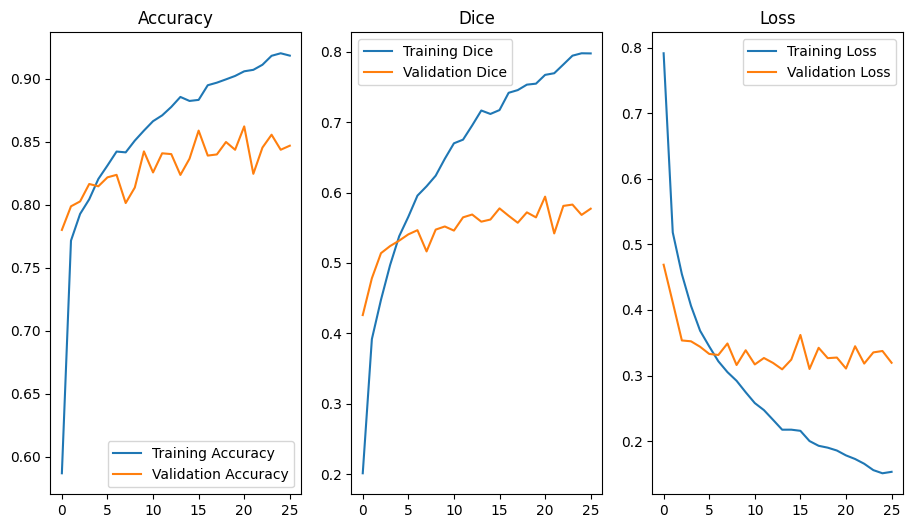

In [44]:
plot_training(history)

We get dice=0.6 on the testing set, as we did for the validation set, proof of no overfitting.

In [45]:
loss, accuracy, dice = model_segmentation_pretrained.evaluate(test_x, test_y.astype('int32'), batch_size=args_pretrained_segmentation.batch_size)
print(f'Test loss: {loss:.4f}, Test accuracy: {accuracy:.4f}, Test dice: {dice:.4f}')

38/38 [==============================] - 9s 149ms/step - loss: 0.2887 - accuracy: 0.8860 - dice_coeff: 0.6077
Test loss: 0.2887, Test accuracy: 0.8860, Test dice: 0.6077


Here we can see an example of some predicted masks vs real. As expected they are much closer that the custom model's.

1/1 [==============================] - 3s 3s/step


<Figure size 640x480 with 0 Axes>

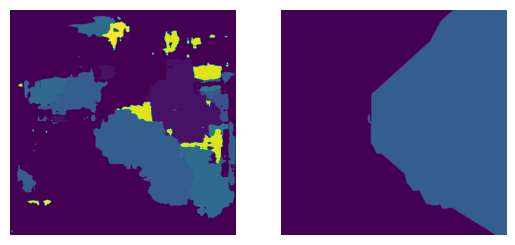

<Figure size 640x480 with 0 Axes>

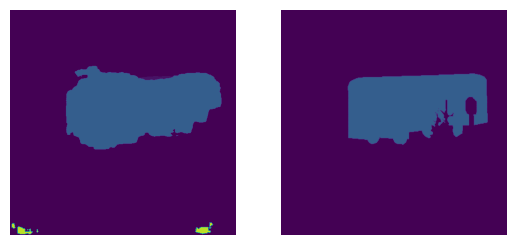

<Figure size 640x480 with 0 Axes>

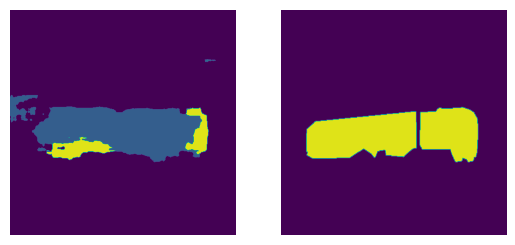

<Figure size 640x480 with 0 Axes>

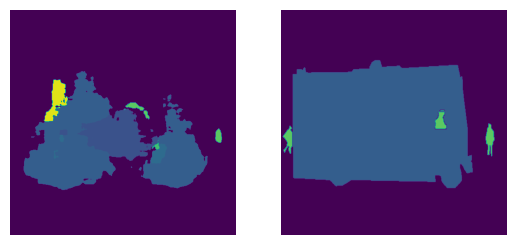

<Figure size 640x480 with 0 Axes>

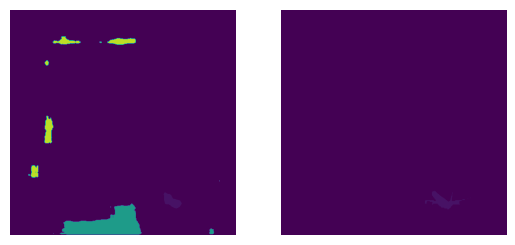

<Figure size 640x480 with 0 Axes>

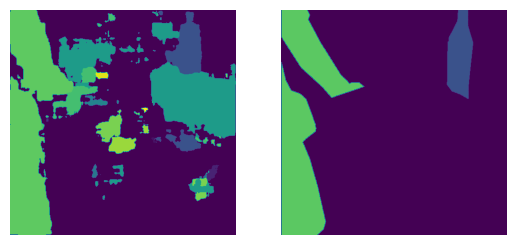

<Figure size 640x480 with 0 Axes>

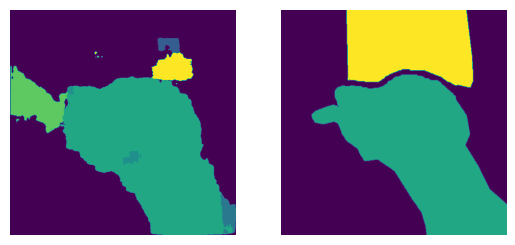

<Figure size 640x480 with 0 Axes>

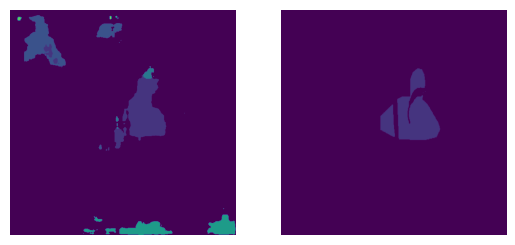

<Figure size 640x480 with 0 Axes>

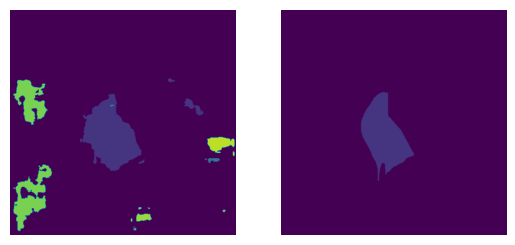

<Figure size 640x480 with 0 Axes>

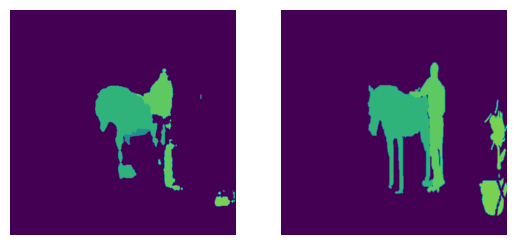

In [46]:
temp = [create_mask(i) for i in model_segmentation_pretrained.predict(test_x[:10])]
for i in range(10):
    plt.figure()
    f, axarr = plt.subplots(1,2)
    axarr[0].imshow(temp[i], vmin=0, vmax=20)
    axarr[1].imshow(test_y[i], vmin=0, vmax=20)
    axarr[0].axis("off")
    axarr[1].axis("off")
    plt.show()

In [47]:
del model_segmentation_custom
# del model_segmentation_pretrained
tf.keras.backend.clear_session()
tf.config.experimental.reset_memory_stats('GPU:0')

## 5. Submit to competition

In [48]:
real_test_df.loc[:, labels] = model_classification_pretrained.predict(resize_dataset(real_test_df['img'],
                                                                                     args_pretrained_classification.input_size[-2::-1]),
                                                                      batch_size=args_pretrained_classification.batch_size)
real_test_df[labels] = real_test_df[labels].applymap(threshold)

del model_classification_pretrained
tf.keras.backend.clear_session()
tf.config.experimental.reset_memory_stats('GPU:0')

47/47 [==============================] - 7s 142ms/step


In [49]:
for i in range(0,len(real_test_df['img']),100):
    preds = model_segmentation_pretrained.predict(resize_dataset(real_test_df['img'][i:i+100],
                                                                                            args_pretrained_segmentation.input_size[-2::-1]),
                                                                             batch_size=1)
    masks = []
    for j, img in enumerate(preds):
        mask = resize_dataset([create_mask(img).astype(np.uint8)],real_test_df['img'][i+j].shape[-2::-1])[0]
        masks.append(mask)
    real_test_df.loc[i:i+99,'seg'] = masks

del model_segmentation_pretrained
tf.keras.backend.clear_session()
tf.config.experimental.reset_memory_stats('GPU:0')

100/100 [==============================] - 5s 34ms/step


/opt/conda/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3156: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  return asarray(a).ndim


50/50 [==============================] - 2s 35ms/step


In [50]:
real_test_df.head(5)

,aeroplane,bicycle,bird,boat,bottle,bus,car,cat,chair,cow,...,horse,motorbike,person,pottedplant,sheep,sofa,train,tvmonitor,img,seg
Id,,,,,,,,,,,,,,,,,,,,,
0,0,0,0,0,0,0,0,0,1,0,...,0,0,1,0,0,0,0,1,"[[[139, 130, 115], [136, 127, 112], [112, 102,...","[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,..."
1,0,0,0,0,0,0,0,0,1,0,...,0,0,0,1,0,1,0,0,"[[[146, 95, 92], [131, 87, 84], [156, 137, 133...","[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,..."
2,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,1,0,0,"[[[121, 122, 108], [121, 122, 106], [125, 122,...","[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,..."
3,0,1,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,"[[[255, 255, 255], [255, 255, 255], [255, 255,...","[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,..."
4,0,0,0,0,0,0,0,0,1,0,...,0,0,0,0,0,0,0,0,"[[[71, 69, 74], [73, 71, 76], [80, 78, 83], [7...","[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,..."


In [51]:
generate_submission(real_test_df).head(5)

,Predicted
Id,
0_classification,9 1 15 1 20 1
0_segmentation,24002 1 24502 2 25002 2 25074 1 25502 2 25576 ...
1_classification,9 1 16 1 18 1
1_segmentation,33128 1 34127 1 35127 1 36127 1 40626 1 40640 ...
2_classification,18 1


# 6. Adversarial attack
For this part, your goal is to fool your classification and/or segmentation CNN, using an *adversarial attack*. More specifically, the goal is build a CNN to perturb test images in a way that (i) they look unperturbed to humans; but (ii) the CNN classifies/segments these images in line with the perturbations.

For this part, your goal is to fool your classification and/or segmentation CNN, using an adversarial attack. More specifically, the goal is build a CNN to perturb test images in a way that (i) they look unperturbed to humans; but (ii) the CNN classifies/segments these images in line with the perturbations.

The goal of adversarial attack is to deceive the algorithm by introducing an engineering output, in order to obtain a incorrect output. There exist many examples in the real world that have used adversarial attacks. The more dangerous examples are the one that introduce noise, which is not visible to the human eye, but can still trick the network into outputting something differently. The latter is an example of evasion attack. The target model is already trained. The attack only creates fake examples that the model cannot recognize. Another type is the poisioning attack. Here the focus is set on modifying the training set in order to attack the network. These are the two most common types of adversial attack.
In the following section we will try two different evasion attacks.

## 6.1 Fast Gradient Sign Method

The first method is the Fast Gradient Sign method. In relies on the fact that you are able to obtain the gradients of the model. Thus in the real world this is already a more difficult approach as you are normally not able to acces the actual parameters. This is the white-box attack. By taking the gradients from the loss function when introducing an image and the delta, a new pertubtation image can be obtained. The delta is initialized with random values. By multiplying the gradients with a perturbation multiplier and adding it to the original image, the perturbated image is obtained. However using this technique we do not control the output of the pertubated image.

In [56]:
train_df, val_df, test_df = np.split(train_df_original.sample(frac=1, random_state=42), [int((1.0-args_custom_classification.val_size-args_custom_classification.test_size)*len(train_df_original)), int((1.0-args_custom_classification.test_size)*len(train_df_original))])# no stratify

train_x_original = resize_dataset(train_df['img'],args_custom_classification.input_size[-2::-1])
train_y_original = train_df[labels]

val_x = resize_dataset(val_df['img'],args_custom_classification.input_size[-2::-1])
val_y = val_df[labels]

test_x = resize_dataset(test_df['img'],args_custom_classification.input_size[-2::-1])
test_y = test_df[labels]

In [57]:
train_x, train_y = data_augmentation(train_x_original,train_y_original,
                                     args_custom_classification.number_of_augmentations,False,
                                     False,args_custom_classification.data_augmentation_file)
print(np.shape(train_y))

no duplicates in dataset
(449, 20)


In [58]:
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.applications import ResNet50
from tensorflow.keras.losses import SparseCategoricalCrossentropy
from tensorflow.keras.applications.resnet50 import decode_predictions
from tensorflow.keras.applications.resnet50 import preprocess_input
import tensorflow as tf
import numpy as np
import argparse
import cv2

def clip_eps(tensor, eps):
    # clip the values of the tensor to a given range and return it
    return tf.clip_by_value(tensor, clip_value_min=-eps,
        clip_value_max=eps)

In [69]:
def generate_adversaries(model, baseImage, delta, classIdx, steps=200): # steps number of gradient descents
    for step in range(0, steps):
        # record our gradients
        with tf.GradientTape() as tape:  

            tape.watch(delta) # track the gradient updates for the perturbation vector! 

            adversary = baseImage + delta # add perturbation to the image

            predictions = model(adversary) # get the prediction of this new image
            predictions = predictions/tf.linalg.norm(predictions)

            loss = -sccLoss(classIdx, predictions)


            if step % 20 == 0:
                print(step, loss.numpy(), classIdx.numpy(), np.argmax( predictions.numpy()))#, predictions.numpy())

        # calculate the gradients of loss with respect to the perturbation vector
        gradients = tape.gradient(loss, delta)
        # update the weights, clip the perturbation vector, and update its value
        optimizer.apply_gradients([(gradients, delta)])
        EPS = 0.1
        delta.assign_add(clip_eps(delta, eps=EPS))


    return delta

In [60]:
def create_adversary(image, model):
    # Expand dimension to give it to the model
    image = tf.expand_dims(image, axis=0)
    # predict the class
    print(model(image))
    class_idx = tf.math.argmax(model(image), axis=1)
    delta = tf.Variable(tf.zeros_like(tf.convert_to_tensor(image)), trainable=True) 
    #delta = tf.Variable(tf.random.normal(image.shape, mean=0.0, stddev=1.0, dtype=tf.dtypes.float32, seed=None, name=None), trainable=True)
    delta = generate_adversaries(model=model, baseImage=image, delta=delta, classIdx=class_idx)
    adversarial_img = delta+image
    new_label = model.predict(adversarial_img)
    return delta, adversarial_img, new_label

# Test for one image
sccLoss = SparseCategoricalCrossentropy()
optimizer = Adam(learning_rate=0.1)

tf.Tensor(
[[0.        0.        0.        0.        0.        0.        1.
  0.        1.        0.        1.        0.        0.        0.9524794
  0.        0.        0.        1.        0.        0.       ]], shape=(1, 20), dtype=float32)
0 -1.599889 [6] 6
20 -2.484907 [6] 2
40 -17.269388 [6] 2
60 -17.269388 [6] 2
80 -17.269388 [6] 2
100 -17.269388 [6] 2
120 -17.269388 [6] 2
140 -17.21671 [6] 2
160 -17.21671 [6] 2
180 -17.21671 [6] 2
1/1 [==============================] - 0s 21ms/step


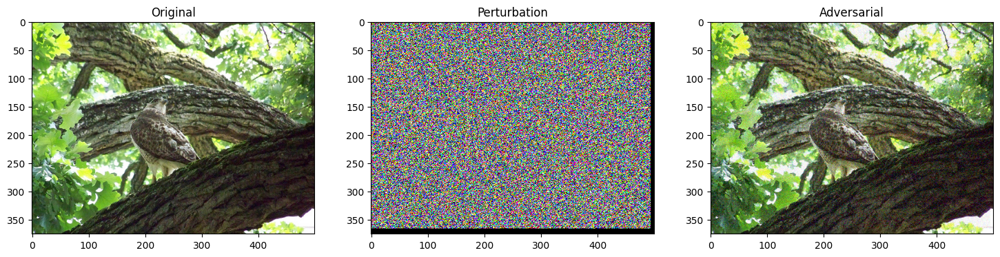

Labels:
Real label:  6   After attack :  2


In [78]:
# Test for one image
sccLoss = SparseCategoricalCrossentropy()
optimizer = Adam(learning_rate=0.1)

i = 8
img = test_x[i]
img = np.array(img).astype(np.float32)
perturbation, adversarial_image, label = create_adversary(image=img, model=model_classification_custom)

fig, axs = plt.subplots(1, 3,figsize=(18, 6))


axs[0].imshow(img.astype(float)/255)
axs[0].set_title("Original")

axs[1].imshow(perturbation[0].numpy().squeeze())
axs[1].set_title("Perturbation")
axs[2].imshow(adversarial_image.numpy().squeeze().astype(float)/255)
axs[2].set_title("Adversarial")
plt.show()

print("Labels:")
print('Real label: ',np.argmax(model_classification_custom(np.expand_dims(img, 0))[0]),'  After attack : ', np.argmax(label))

tf.Tensor(
[[0.         0.         0.         0.99998426 0.         0.
  0.         0.         0.         0.         0.         0.
  1.         1.         0.         0.         0.         0.
  0.         0.        ]], shape=(1, 20), dtype=float32)
0 -1.098608 [12] 12
20 -2.6390574 [12] 0
40 -2.7080503 [12] 0
60 -2.7080503 [12] 0
80 -2.7080503 [12] 0
100 -2.7080503 [12] 0
120 -2.7080503 [12] 0
140 -2.7725887 [12] 0
160 -2.7725887 [12] 0
180 -2.7725887 [12] 0
1/1 [==============================] - 0s 20ms/step


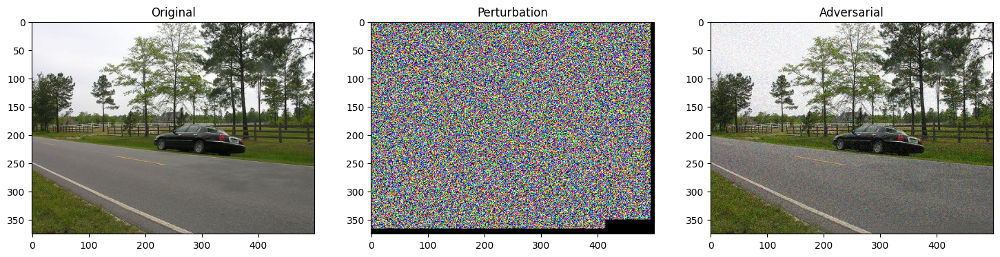

Labels:
Real label:  12   After attack :  0


In [79]:
# Test for one image
sccLoss = SparseCategoricalCrossentropy()
optimizer = Adam(learning_rate=0.1)

i = 11
img = test_x[i]
img = np.array(img).astype(np.float32)
perturbation, adversarial_image, label = create_adversary(image=img, model=model_classification_custom)

fig, axs = plt.subplots(1, 3,figsize=(18, 6))


axs[0].imshow(img.astype(float)/255)
axs[0].set_title("Original")

axs[1].imshow(perturbation[0].numpy().squeeze())
axs[1].set_title("Perturbation")
axs[2].imshow(adversarial_image.numpy().squeeze().astype(float)/255)
axs[2].set_title("Adversarial")
plt.show()

print("Labels:")
print('Real label: ',np.argmax(model_classification_custom(np.expand_dims(img, 0))[0]),'  After attack : ', np.argmax(label))

We can see that the adversial attack works! The original image is slightly modified which is not even visiable. The amount of noise can be controller using the epsilon parameter. The higher the paremeter the easier it is to fool the network but the more visual it becomes. However for our problem we can have a very low epsilon. As we are in the white-box setting this type of attack is unrealistic. Normally the attacker has almost no information on the model or no acces.
A way to generalize well to adversial attacks, would be to add adversial examples generated through such an attack. Thereby the model can also detect it. At the same time it would be a good idea to regularly monitor the model behavior if the consequences of adversial attack could be very bad.

https://drive.google.com/file/d/1ZbaT-4nW5FdSMhf8fgK4SkzJ4ZFB55VJ/view?usp=share_link 

https://drive.google.com/file/d/1lkA6PyIfXv5eKS414a1o64EvmHy3ZopF/view?usp=share_link

Here are some examples of the adversial attacks.

## 6.2 Encoder-decoder

nstead of using a simple gradient descent method to generate adversarial images, it is also possible to generate these images with an encoder-decoder. The idea is that the encoder-decoder learns to generate adversarial images from the gradients of the classification model. This can be done by starting with an encoder-decoder that is the Identity function, which means that input and output are the same. This encoder-decoder is the first 'layer' of the adversarial model, the second layer is the classification model we want to fool. The adversarial model is than trained by freezing the classification model and changing all training labels to the desired label of the adversarial images. Using categorical cross entropy loss then results in teaching the encoder-decoder to perturb the input images so that the classifier will predict the desired label. The encoder-decoder should output images that look the same as the input images to the human eye, therefore we need some regularization in the layers of the encoder-decoder.

In [ ]:
args_adv = argparse.Namespace(
    use_data_augmentation = False,
    run_training = True,
    continue_training = True,

    early_stopping_patience = 15,
    learning_rate = 0.005,

    run_data_augmentation = False,
    number_of_augmentations = 5,
    checkpoint_file = './checkpoints/adversary/checkpoint.ckpt',
    history_file = './checkpoints/adversary/history.pkl',
    input_size = (375,500,3),
    data_augmentation_file = './train_augmented_5.pkl',
    val_size = 0.2,
    test_size = 0.2,
    batch_size = 4
)

We use a simple Convolutional network for the encoder-decoder. Because the input images are odd shaped, one cropping layer is added to make sure the output is of the same shape as the input.

In [ ]:
from keras.models import Model
from keras.initializers import Identity, Zeros
regularization = 0.1
class AutoEncoder(Model):
    def __init__(self):
        super(AutoEncoder, self).__init__() 

        self.encoder = tf.keras.Sequential([
                layers.Input(shape=(375, 500, 3)),
                layers.Conv2D(16, (3, 3), activation='relu', padding='same', strides=2, kernel_regularizer=regularizers.l2(l=regularization), kernel_initializer=Zeros),
                layers.Conv2D(8, (3, 3), activation='relu', padding='same', strides=2, kernel_regularizer=regularizers.l2(l=regularization), kernel_initializer=Zeros)])
        self.decoder = tf.keras.Sequential([
                layers.Conv2DTranspose(8, kernel_size=3, strides=2, activation='relu', padding='same', kernel_regularizer=regularizers.l2(l=regularization), kernel_initializer=Zeros),
                layers.Conv2DTranspose(16, kernel_size=3, strides=2, activation='relu', padding='same', kernel_regularizer=regularizers.l2(l=regularization), kernel_initializer=Zeros),
                layers.Conv2D(3, kernel_size=(3, 3), activation='sigmoid', padding='same', kernel_regularizer=regularizers.l2(l=regularization), kernel_initializer=Zeros),
                layers.Cropping2D(cropping=((1, 0), (0, 0)), data_format=None)])

    def call(self, x):
        y = self.encoder(x)
        y = self.decoder(y)
        return y

autoEncoder_model = AutoEncoder()

The encoder-decoder model is trained with as input the training images and as desired output the same training images are given. The mean squared error between two images is zero of they are the same so this model should converge to the identity function. Unfortunately, even though we tried several configurations of this model, it did not learn to output the same images it is given as input.

In [ ]:
history = None
if args_adv.continue_training:
    autoEncoder_model.load_weights(args_adv.checkpoint_file)
    with open(args_adv.history_file, 'rb') as f:
                history = pickle.load(f)


autoEncoder_model.compile(optimizer=optimizers.Adam(learning_rate=args_adv.learning_rate),
              loss=losses.MeanSquaredError(reduction=tf.keras.losses.Reduction.SUM_OVER_BATCH_SIZE))

if args_adv.run_training:
    checkpoints = tf.keras.callbacks.ModelCheckpoint(args_adv.checkpoint_file, save_best_only=False, save_weights_only=True, verbose=1)

    history = autoEncoder_model.fit(x=train_x, y=train_x, callbacks=[checkpoints],
                        epochs=1000, validation_data=(val_x,val_x), batch_size=args_adv.batch_size)
    history = history.history
    with open(args_adv.history_file, 'wb') as f:
                pickle.dump(history, f)

Here, we plot four original images and their output. Right now the goal is to output the same images which were given as input, but this clearly does not work yet as the output is just a black image.

In [ ]:
nbImages = 4
out_imgs = autoEncoder_model(train_x[0:nbImages]).numpy()
print(out_imgs.shape)

fig, axs = plt.subplots(2, nbImages)
for i in range(nbImages):
    axs[0, i].imshow(train_x[i].astype(float)/255)
    axs[0, i].set_title(f"Input")
    axs[1, i].imshow(out_imgs[i].astype(float)/255)
    axs[1, i].set_title(f"Output")

plt.show()

Combining the encoder-decoder with the classification model

To make it easy to train the encoder-decoder to generate adversarial images, we combine it with the classification model. The weights of the classification model are frozen, otherwise we would just train the classification model to classify every image as the desired label, without necessarily training the encoder-decoder. We also create the labels for training the adversarial model. These labels are just all the same, the desired label, which we chose to be class 0.

In [ ]:
from keras.models import Model
class Adversary(Model):
    def __init__(self):
        super(Adversary, self).__init__() 

        self.encoder = autoEncoder_model
        self.predictor = model_classification_custom
        self.predictor.trainable = False

    def call(self, x):
        x = self.encoder(x)
        return self.predictor(x)
    
    def getAdversary(self, x):
        x = self.encoder(x)
        return x

model_adv = Adversary()

# Change all labels to the first class:
train_y_adv = np.zeros(train_y.shape)
train_y_adv[:, 0] = 1
train_y_adv = tf.convert_to_tensor(train_y_adv)
val_y_adv = np.zeros(val_y.shape)
val_y_adv[:, 0] = 1
val_y_adv = tf.convert_to_tensor(val_y_adv)

Training the adversarial model

The model is then trained with categorical cross entropy. This learns the encoder decoder to perturb the images so they are classified by the classification model as class 0. For now it does not make sense to try to train this model, as we do not have an encoder-decoder model that already learned the Identity function. Because the encoder-decoder always outputs the same black image, this image is always classified as the same class. This results in the encoder-decoder learning to again always output the same image that is classified as the desired class.

In [ ]:
if args_adv.continue_training:
    model_adv.load_weights(args_adv.checkpoint_file)
    with open(args_adv.history_file, 'rb') as f:
                history = pickle.load(f)

class_counts = np.sum(train_y, axis=0)
total_counts = np.sum(class_counts)
class_weights = {i: total_counts/(class_counts[i]*20) for i in range(20)}

model_adv.compile(optimizer=optimizers.Adam(learning_rate=args_adv.learning_rate),
              loss=losses.CategoricalCrossentropy(),
              metrics=['accuracy',dice_coeff])

if args_adv.run_training:
    checkpoints = tf.keras.callbacks.ModelCheckpoint(args_adv.checkpoint_file, save_best_only=False, save_weights_only=True, verbose=1)

    history = model_adv.fit(x=train_x, y=train_y_adv, callbacks=[checkpoints], class_weight=class_weights,
                        epochs=100, validation_data=(val_x,val_y_adv), batch_size=args_adv.batch_size)
    history = history.history
    with open(args_adv.history_file, 'wb') as f:
                pickle.dump(history, f)

Plotting adversarial images

Here, we plot the original images and the images perturbed by the encoder-decoder, together with their labels predicted by the classification model.

In [ ]:
nbImages = 4
adv_imgs = model_adv.getAdversary(train_x[0:nbImages]).numpy()

fig, axs = plt.subplots(2, nbImages)
for i in range(nbImages):
    axs[0, i].imshow(train_x[i].astype(float)/255)
    axs[0, i].set_title(f"Original: {np.argmax(train_y[i])}")
    axs[1, i].imshow(adv_imgs[i].astype(float)/255)
    newlabel = np.argmax(model_classification_custom(np.expand_dims(train_x[0], 0))[0])
    axs[1, i].set_title(f"Perturbed: {newlabel}")

plt.show()

# 7. Discussion
Finally, take some time to reflect on what you have learned during this assignment. Reflect and produce an overall discussion with links to the lectures and "real world" computer vision.

What we could do better in Classification:
1. Use better class weights, for example instead of total_counts/(class_counts*20) we could use that times sqrt(factor*max(class_counts)/class_counts) and then pass that through a sigmoid function to project it to (0,1). That would give us more smooth weights that can be controlled through factor to be more or less aggressive (have more or less variance).
2. We tried much larger and smaller custom models and all of them overfitted the data. One thing we couldn't try because of vram limitations is a deep CNN with batch normalization layers instead of l2 and unit norm. We couldn't use batch regularization layers in a deep model because the batch size would be too small because of vram limitations. That's why we opted for different regularization techniques.
3. We could use [sk-muli-learn](http://scikit.ml/stratification.html) to split our dataset using stratify the correct way (sklearn stratify doesn't work optimally for multilabel).
4. We could replace the last max pooling with AdaptiveMaxPool2d to make our model be able to accept images of any size. We could also add a random resizing layer to our dataset augmentation. In order to train such model each batch should be composed of images of the same size. That means that we either have to have batch size 1 (slow training and batch normalization doesn't work) or create a dataloader that s the images with the same size into the same batches.

What we could do better in Segmentation:
1. Use better weights, instead of manually selecting the weights we can calculate them as suggested in 1. of classification.
2. We could use more rounds of data augmentations for the custom model (we didn't because of ram restrictions)
3. We could stratify the images based on there classification labels.
4. As with the classification models we could make our segmentation models accept images of any size.



For adversial attacks:

1. Different tests were conducted. First all the images in the dataset were used. Each label was changed to correspond with only class. Thereby the loss function aims to inject the gradients back to the network to predict this new label. The second test was to only use a small set of images. Only images containing cars and planes were chosen. Then all the labels were set only to planes. This could have made the learning easier by reducing the difficulty. However for both tests the model did not learn anything. Different labels were predicted but not the correct ones. 
2. Another way would be to train a more computational expensive model. 